# 2025.1113

This notebook analysis 2015 SA pulse with EKF-RNN  magnetomap
generated by the following program: 
- with Zonal terms, without LOD input:
    - `program_files/2025_1016_learn_derivatives_h34_s0-32_Zonal.py`
    - `program_files/2025_1028_learn_derivatives_h34_s0-32_Zonal_bw.py`
    - `program_files/2025_1030_learn_derivatives_h34_s29_Zonal_d3g.py`
    - `program_files/2025_1031_learn_derivatives_h34_s29_Zonal_d0g.py`
- omnly non-Zonal terms, without LOD input:
    - `program_files/2025_1018_learn_derivatives_h34_s0-32_nonZonal.py`
    - `program_files/2025_1029_learn_derivatives_h34_s0-32_nonZonal_bw.py`
- with LOD input:
    - `program_files/2025_1106_withLOD_h34_s0-32_nonZonal.py`
    - `program_files/2025_1108_withLOD_h34_s0-32_Zonal.py`

for SGEPSS.


Candidate model
- Number of hidden units : `Drec = 34`
- initial $\mathbf{w}_0$ : `seed = best / worst in "00000" - "11111"` (`seed = 29 "11101"` was for IGRF-14)
- Training method : EKF-RNN

`Data Period: MCM-2024 (2004.87〜2024.87)`

- Hindcast experiment (Minami et al., 2020)  
`Train Period: 2004.8739 - 2018.6247 (56 points, 14 yrs )`  
`Valid Period: 2018.8749 - 2023.6254 (20 points, 5 yrs )`  


In [1]:
# Import the packages and bespoke functions from src folder
import os
import sys
import glob

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
sys.path.append('..')

import shapefile  # from package pyshp >= 2.3.1, pip install pyshp
shp = os.path.abspath('./external/ne_110m_coastline.zip')

from src import sha_lib as shal
from src import shc_utils as shau

# Set up line colour/type/marker properties using cycler
from cycler import cycler
cc = ( cycler(linestyle=['-', '--', '-.',':']) *
       cycler(color=list('rgbk')) *
       cycler(marker=['none', 's', '.']))

## Configure input

User sets the following variables:

In [2]:
# Access candidate models in the ../data/IGRF13/DGRF directory
# Declare the fixed constants
field_type = 'main'   # 'main' or 'sv'
candidate = 'SV'    # 'DGRF', 'IGRF' or 'SV'
year = '2025'         # For labelling

IGRFSV_DIR = os.path.abspath('./SA_gap_cofs/*.cof')

In [3]:
"""

Check files are correctly formatted

"""
print('List of ' + candidate + ' Candidates \n ----------- ')
files = sorted(glob.glob(IGRFSV_DIR))
print(*files, sep='\n')

pass_or_fail = shau.check_cof_file_format(files, field_type)

if not(pass_or_fail).all():
    raise Exception('A candidate model format is incorrect. Fix it before \
                    continuing')

# Load in the coefficients - define the type (main or sv) and the leading
# acronym on the filename
[coeffs, institute_name, degree] = \
         shau.load_coeffs_to_numpy(sorted(files), field_type, candidate)
num_candidates = coeffs.shape[1]

List of SV Candidates 
 ----------- 
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2014.12.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2014.37.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2014.62.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2014.87.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2015.13.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD-MCM_2015.38.cof
/Users/satosho/Library/CloudStorage/OneDrive-KyotoUniversity/relay_lab_pc/main_lab_pc_2025/program_files/SA_gap_cofs/SA_LOD

SA_LOD-MCM_2014.12
contains np.nan?  False
plot done


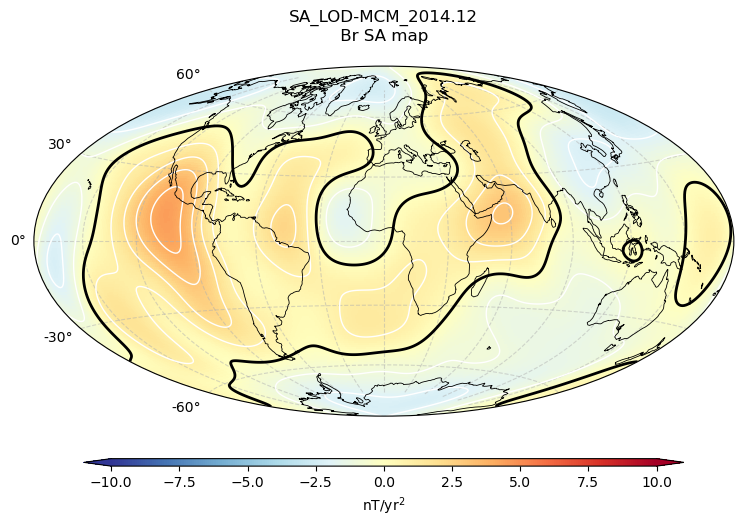

SA_LOD-MCM_2014.37
contains np.nan?  False
plot done


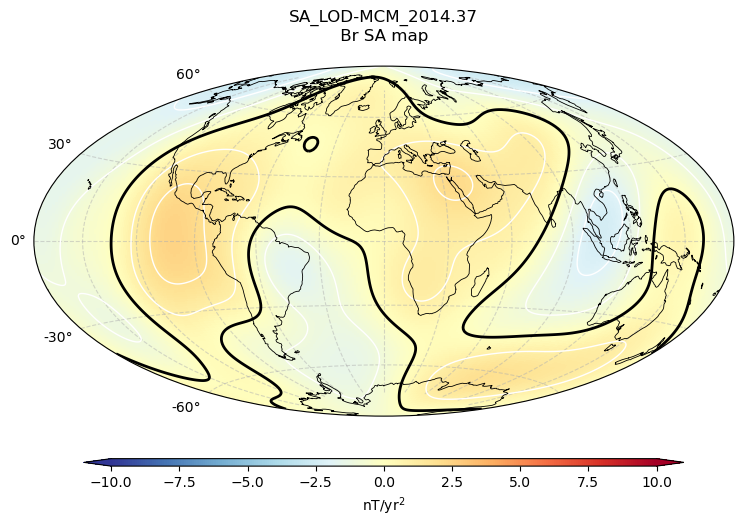

SA_LOD-MCM_2014.62
contains np.nan?  False
plot done


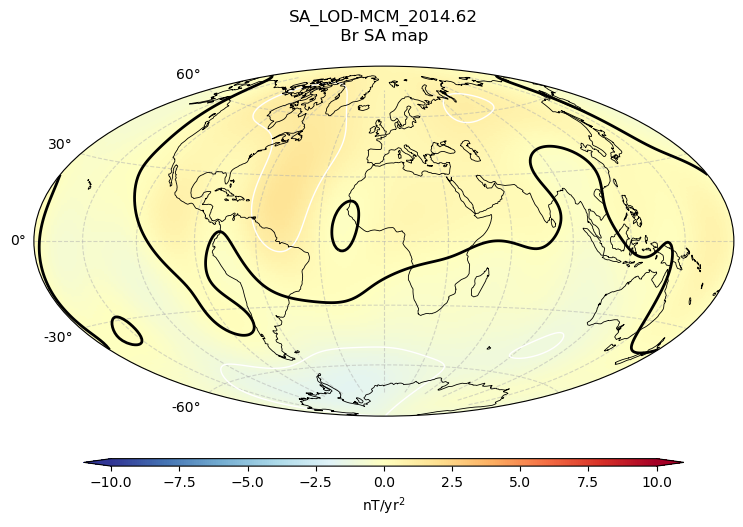

SA_LOD-MCM_2014.87
contains np.nan?  False
plot done


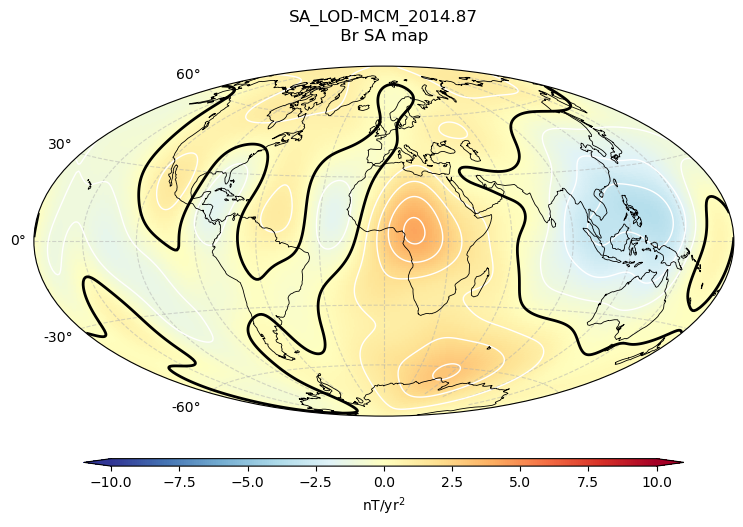

SA_LOD-MCM_2015.13
contains np.nan?  False
plot done


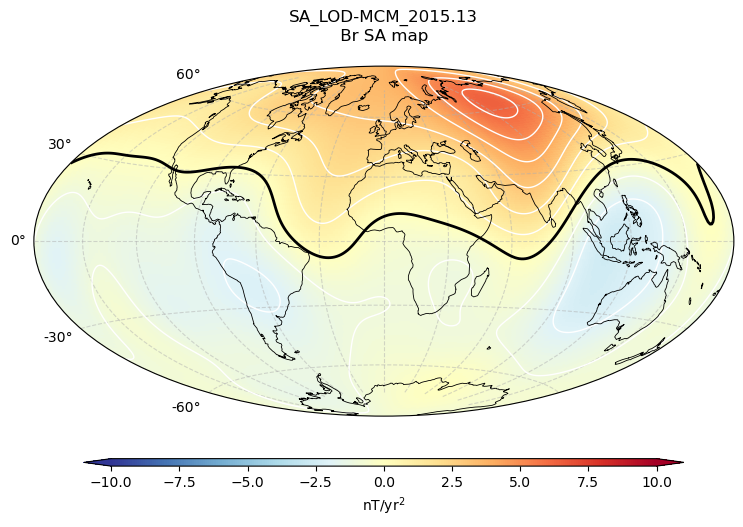

SA_LOD-MCM_2015.38
contains np.nan?  False
plot done


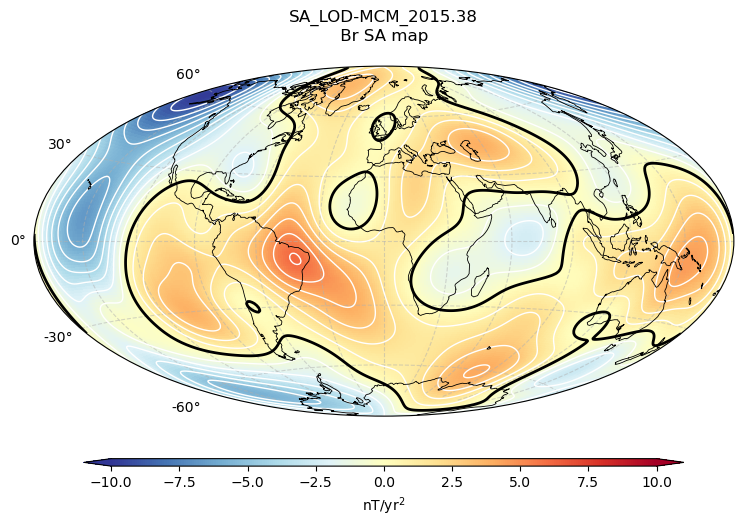

SA_LOD-MCM_2015.63
contains np.nan?  False
plot done


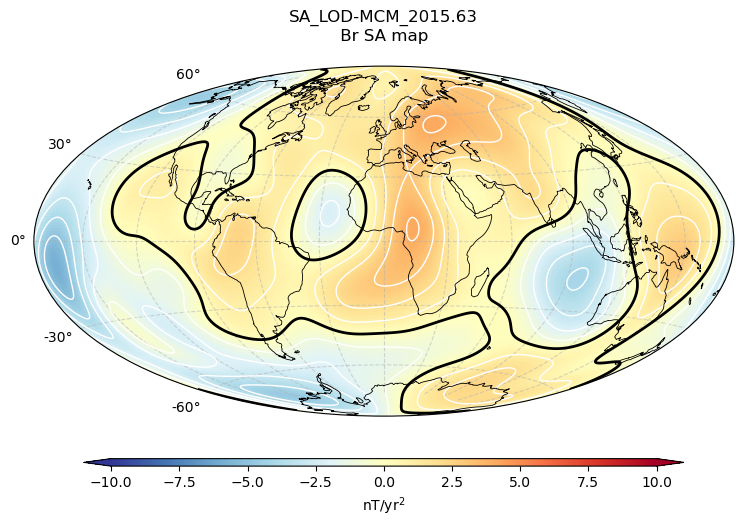

SA_LOD-MCM_2015.88
contains np.nan?  False
plot done


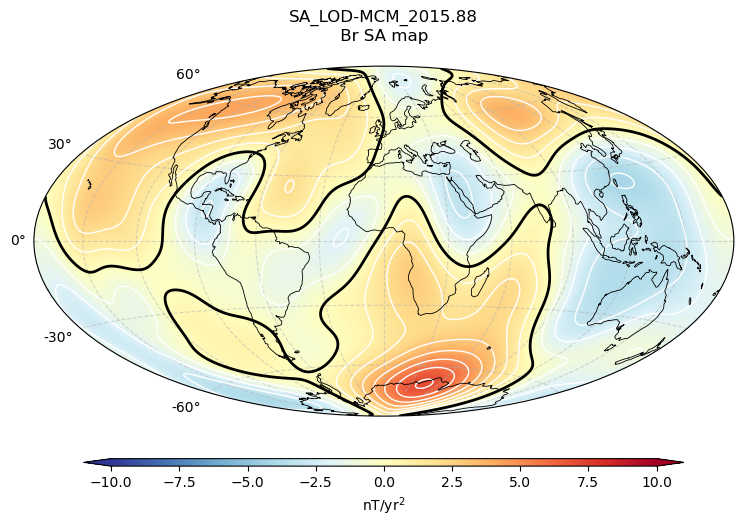

SA_LOD-MCM_2016.12
contains np.nan?  False
plot done


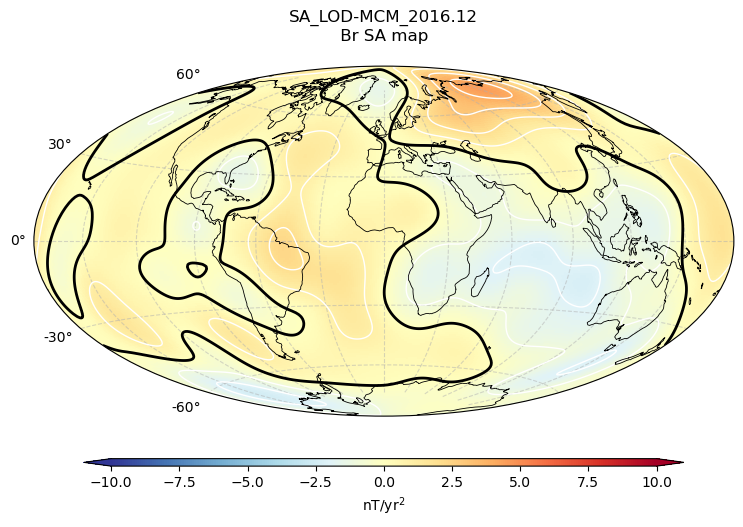

SA_LOD-MCM_2016.37
contains np.nan?  False
plot done


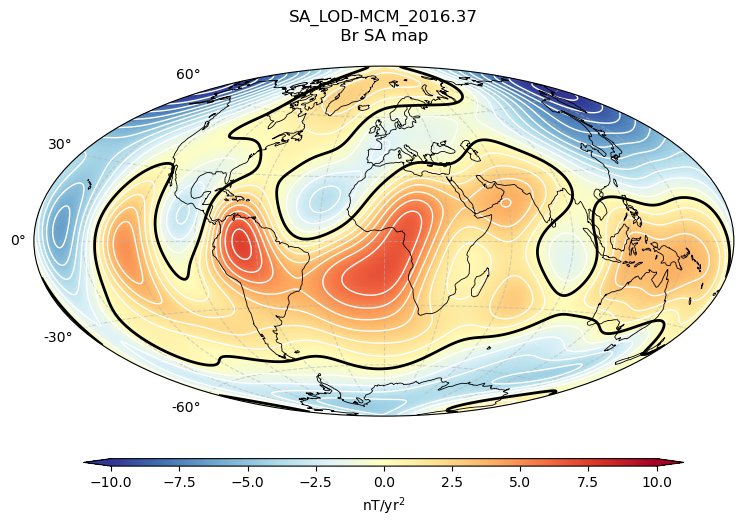

SA_LOD-MCM_2016.62
contains np.nan?  False
plot done


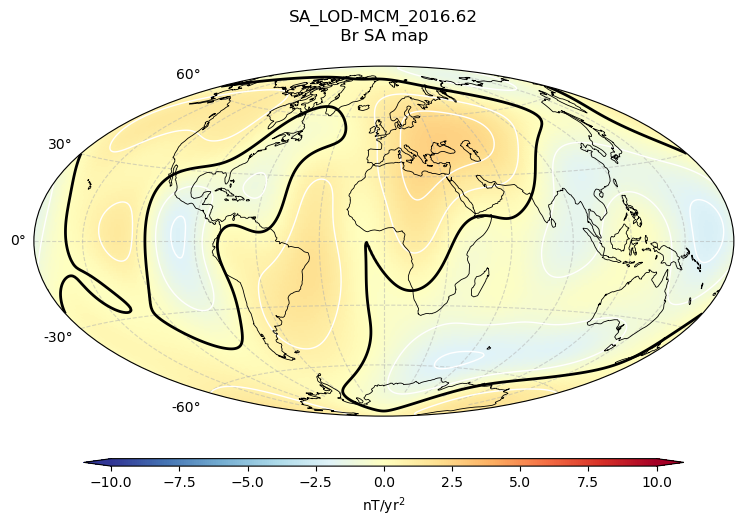

SA_LOD-MCM_2016.87
contains np.nan?  False
plot done


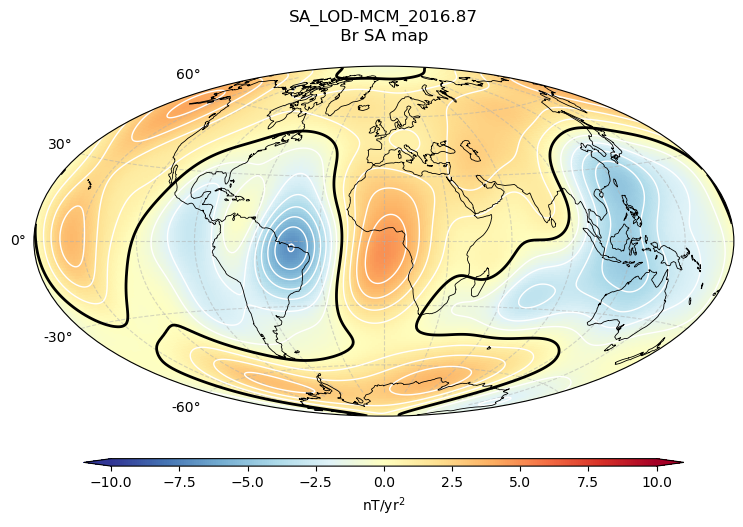

SA_LOD-MCM_2017.12
contains np.nan?  False
plot done


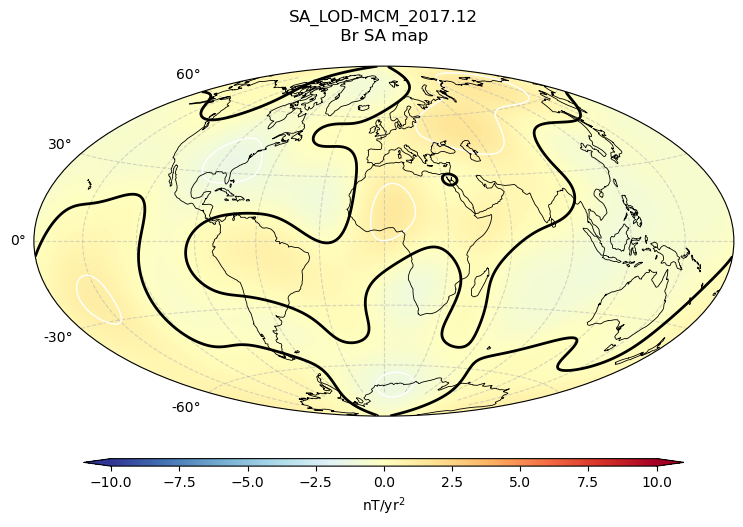

SA_LOD-MCM_2017.37
contains np.nan?  False
plot done


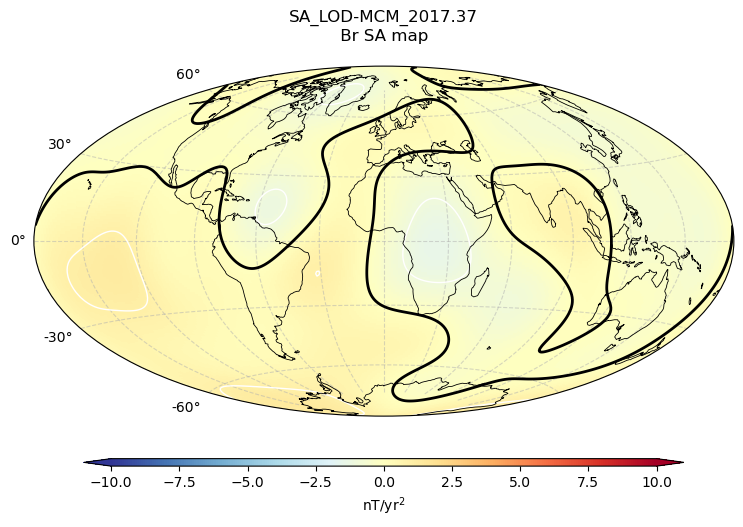

SA_LOD-RNN_2014.12
contains np.nan?  False
plot done


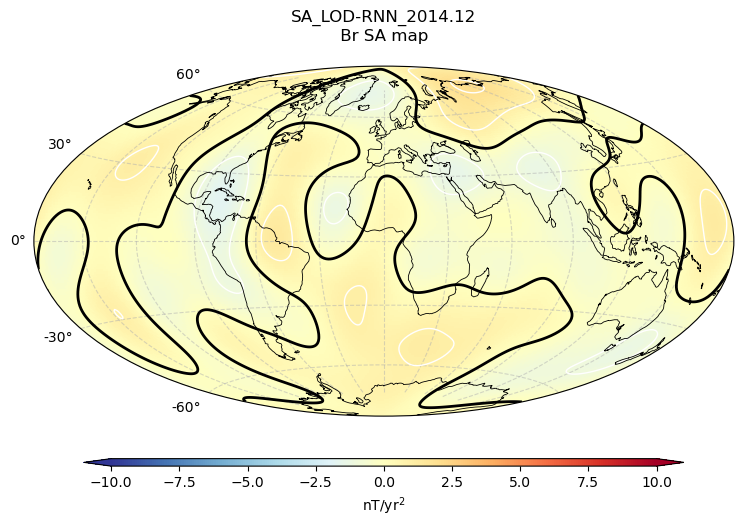

SA_LOD-RNN_2014.37
contains np.nan?  False
plot done


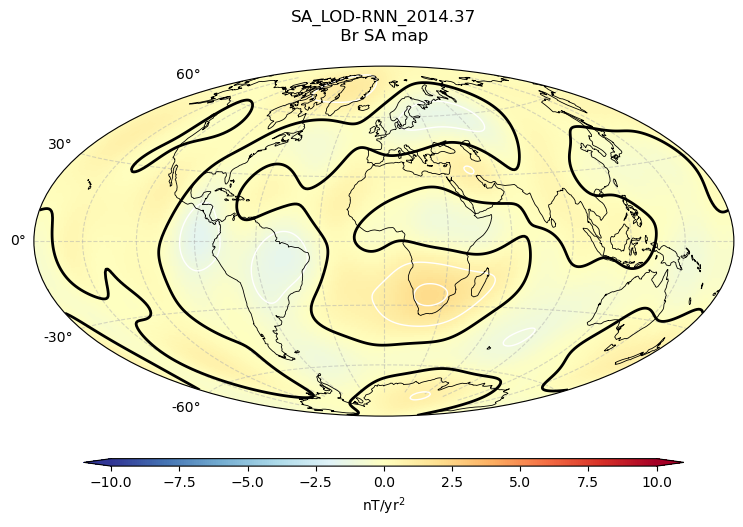

SA_LOD-RNN_2014.62
contains np.nan?  False
plot done


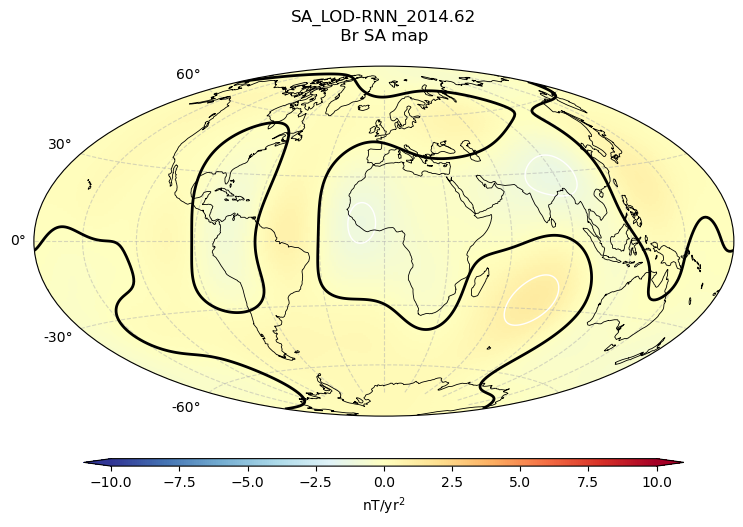

SA_LOD-RNN_2014.87
contains np.nan?  False
plot done


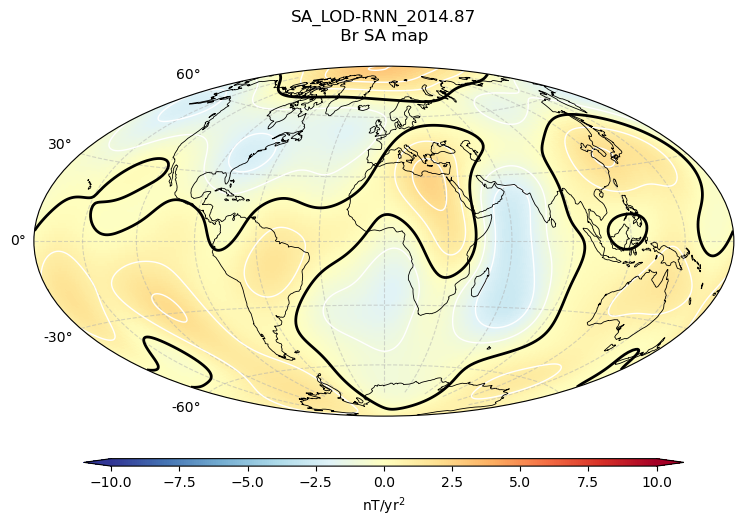

SA_LOD-RNN_2015.13
contains np.nan?  False
plot done


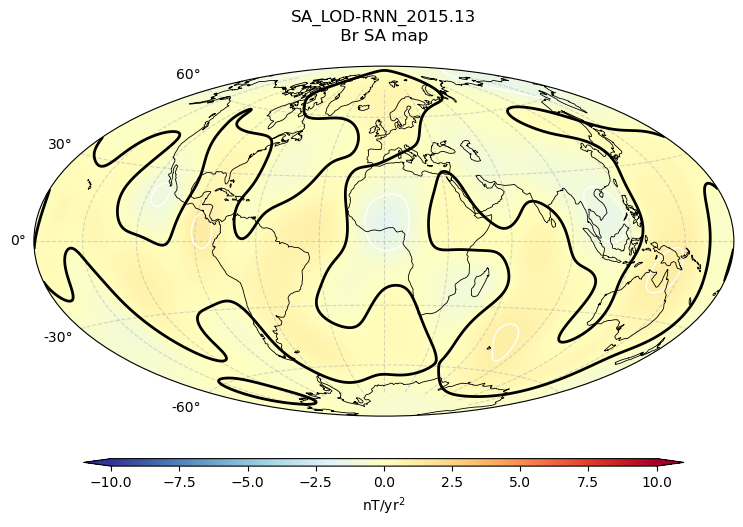

SA_LOD-RNN_2015.38
contains np.nan?  False
plot done


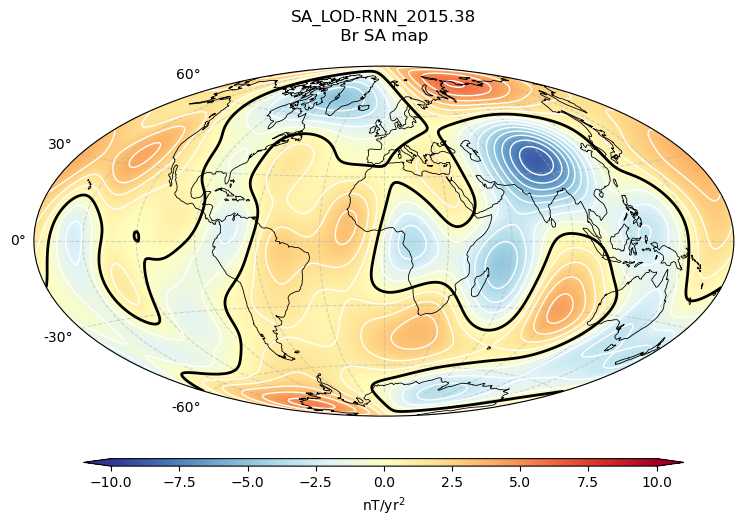

SA_LOD-RNN_2015.63
contains np.nan?  False
plot done


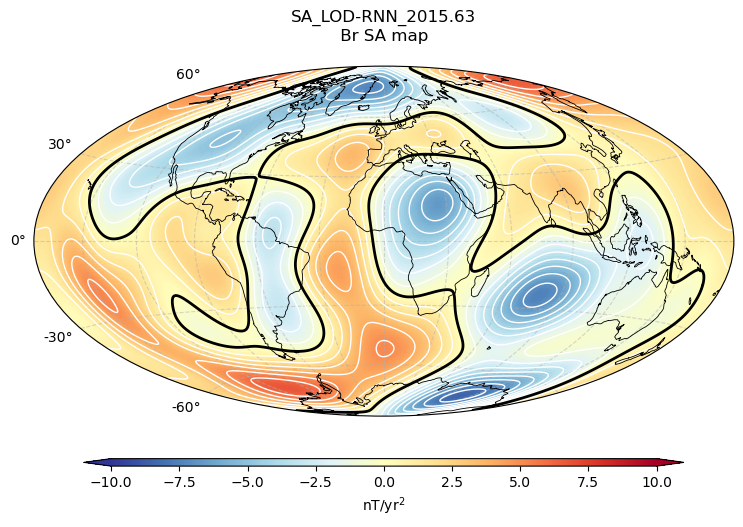

SA_LOD-RNN_2015.88
contains np.nan?  False
plot done


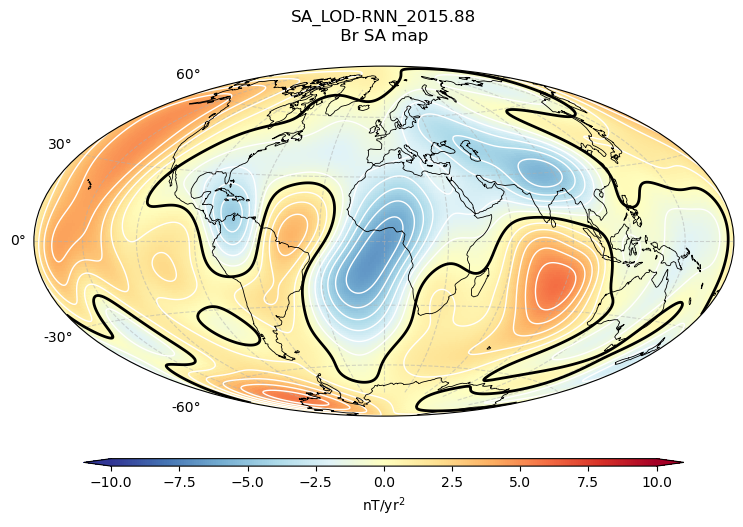

SA_LOD-RNN_2016.12
contains np.nan?  False
plot done


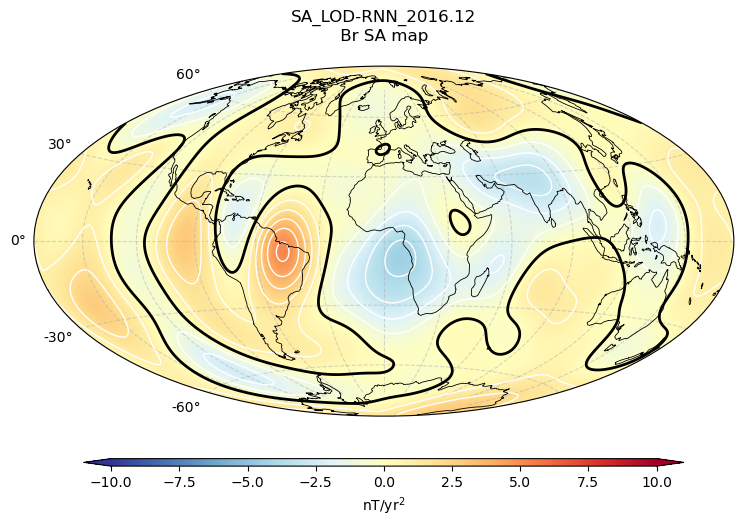

SA_LOD-RNN_2016.37
contains np.nan?  False
plot done


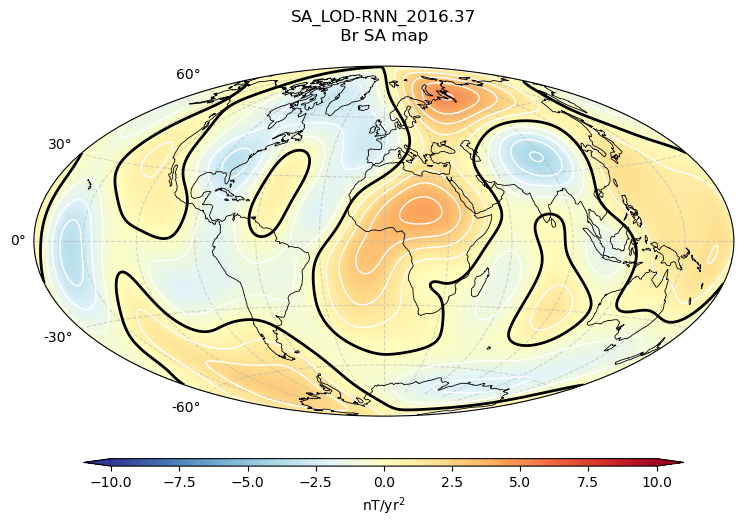

SA_LOD-RNN_2016.62
contains np.nan?  False
plot done


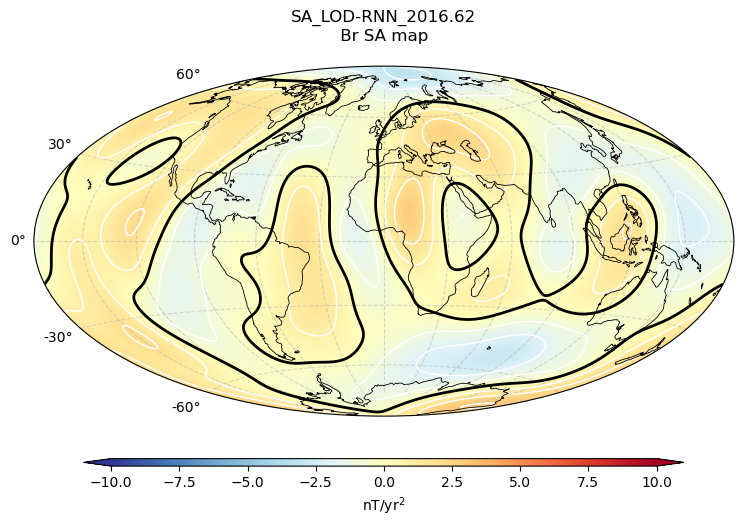

SA_LOD-RNN_2016.87
contains np.nan?  False
plot done


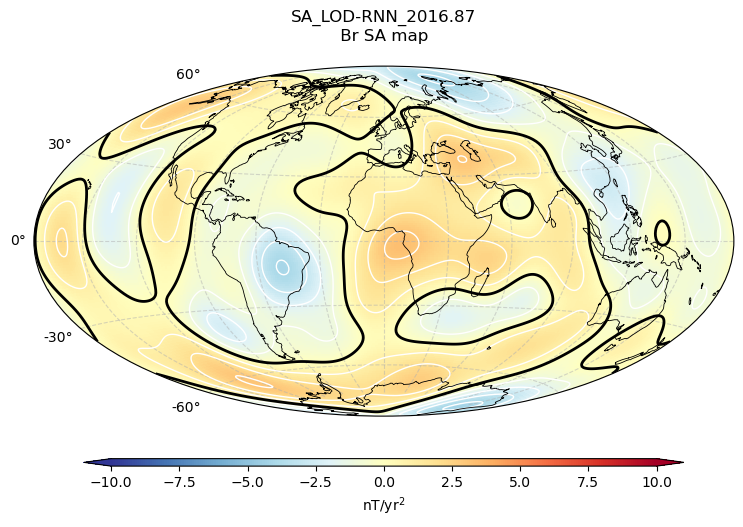

SA_LOD-RNN_2017.12
contains np.nan?  False
plot done


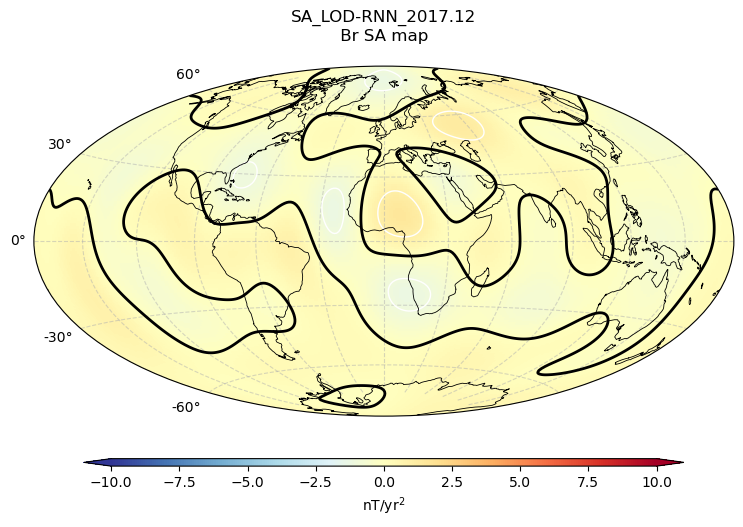

SA_LOD-RNN_2017.37
contains np.nan?  False
plot done


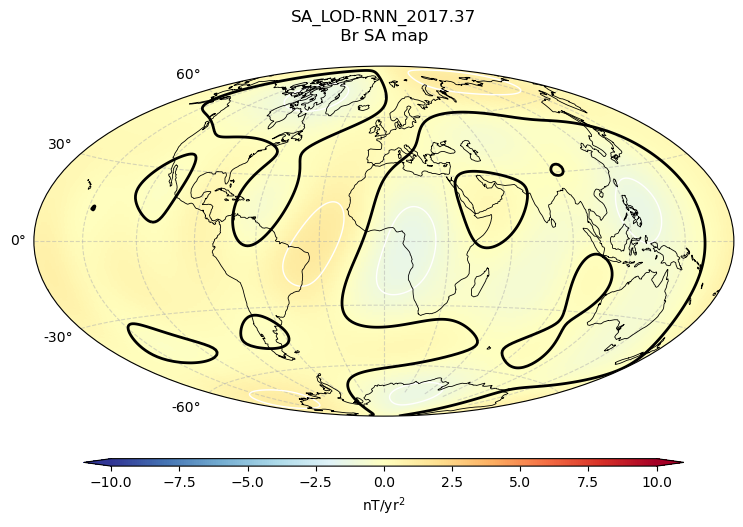

SA_RNN-MCM_2014.12
contains np.nan?  False
plot done


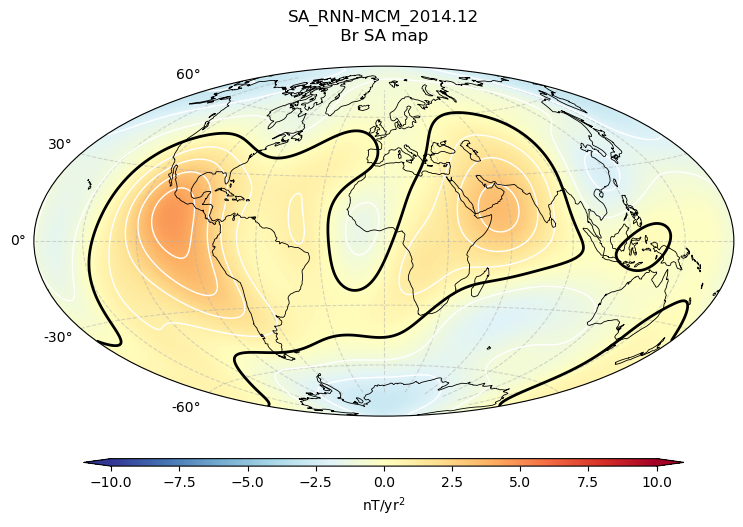

SA_RNN-MCM_2014.37
contains np.nan?  False
plot done


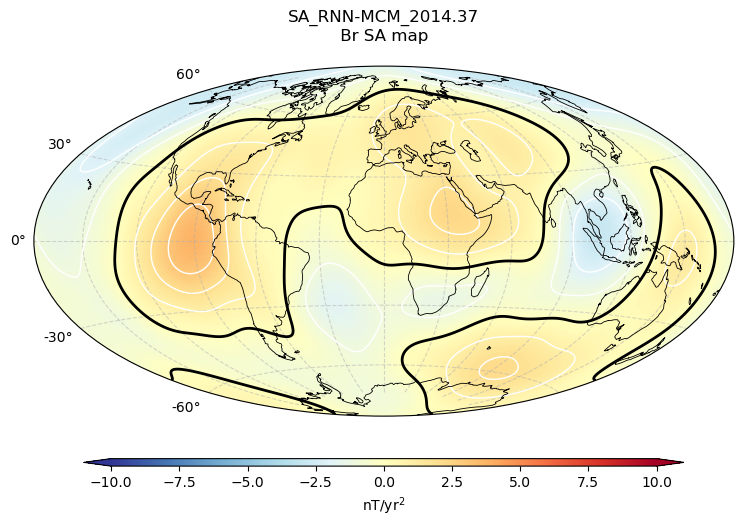

SA_RNN-MCM_2014.62
contains np.nan?  False
plot done


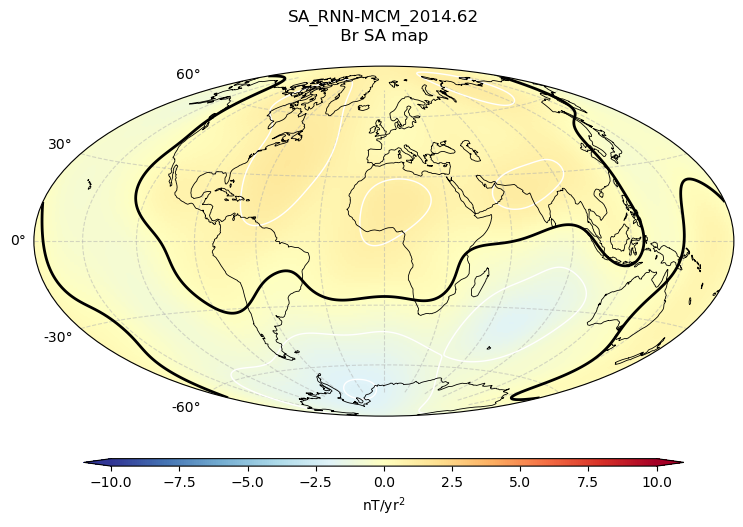

SA_RNN-MCM_2014.87
contains np.nan?  False
plot done


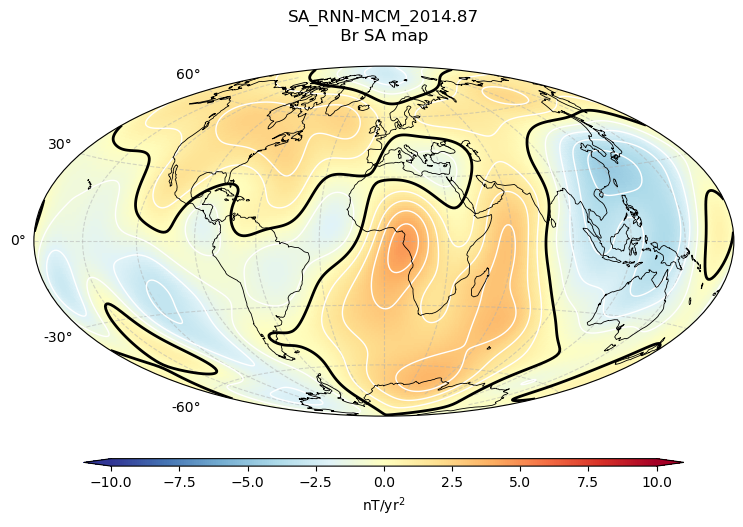

SA_RNN-MCM_2015.13
contains np.nan?  False
plot done


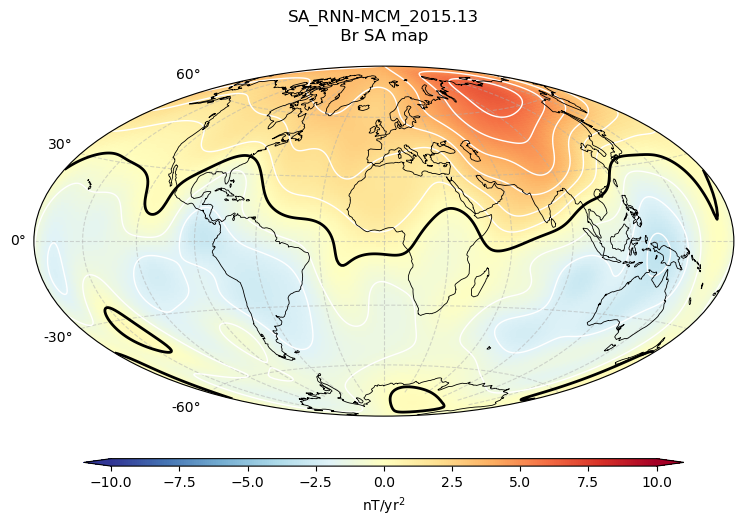

SA_RNN-MCM_2015.38
contains np.nan?  False
plot done


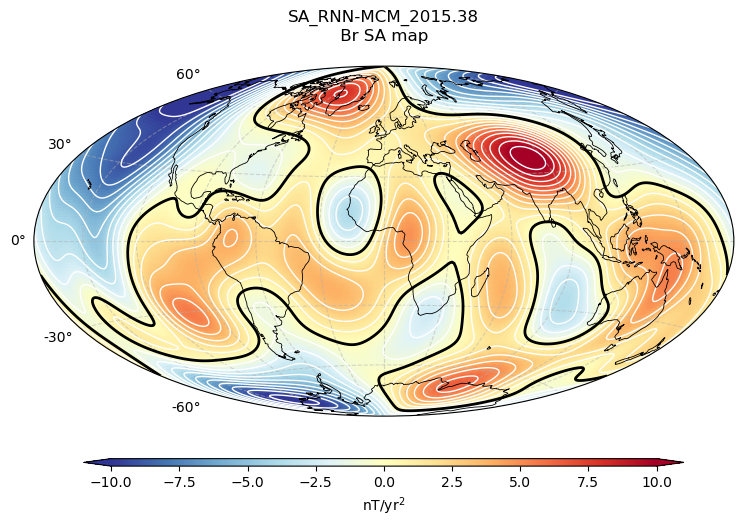

SA_RNN-MCM_2015.63
contains np.nan?  False
plot done


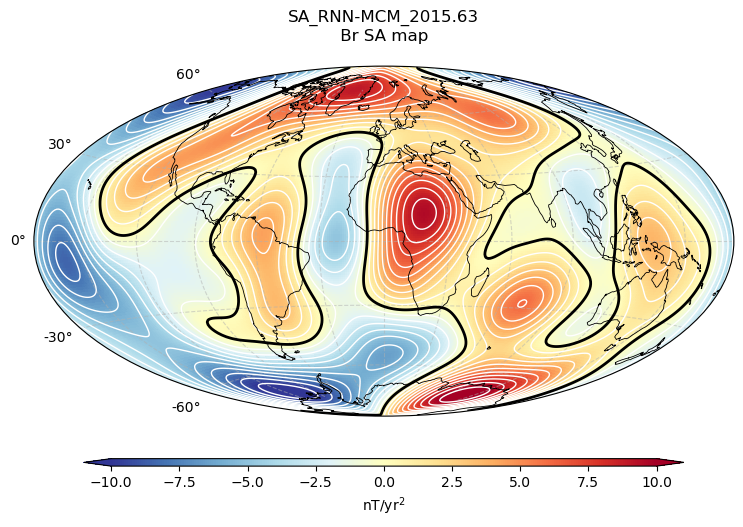

SA_RNN-MCM_2015.88
contains np.nan?  False
plot done


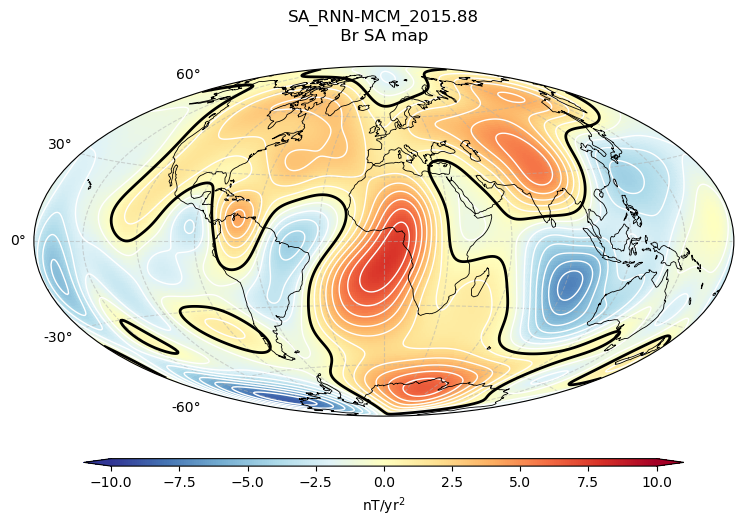

SA_RNN-MCM_2016.12
contains np.nan?  False
plot done


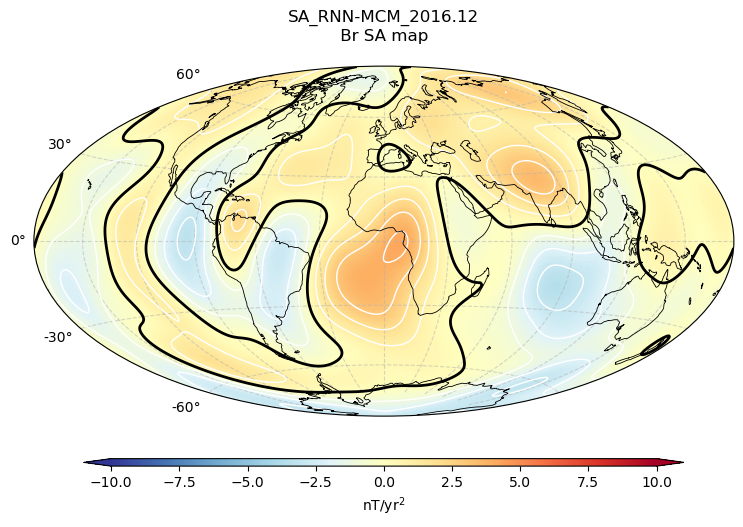

SA_RNN-MCM_2016.37
contains np.nan?  False
plot done


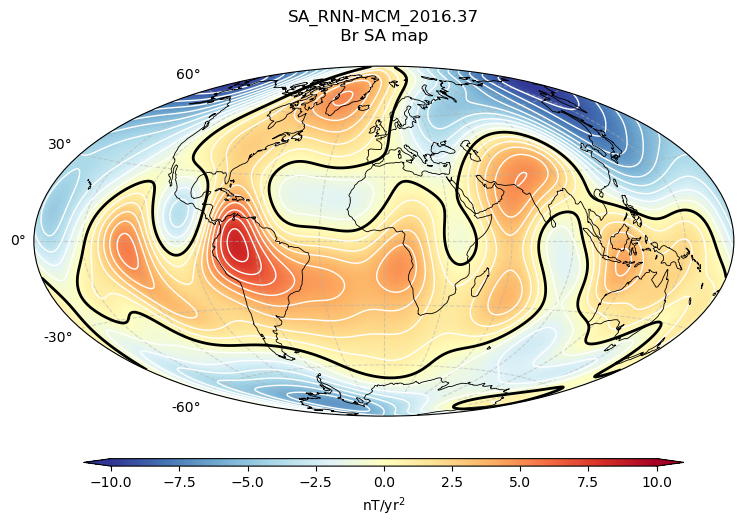

SA_RNN-MCM_2016.62
contains np.nan?  False
plot done


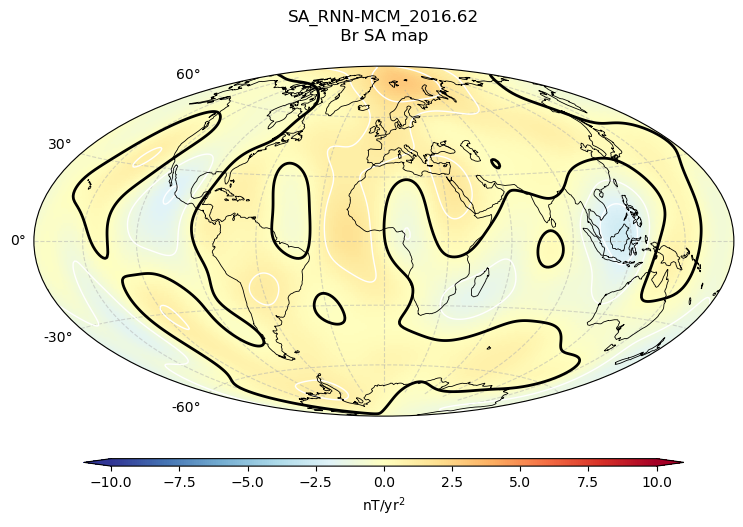

SA_RNN-MCM_2016.87
contains np.nan?  False
plot done


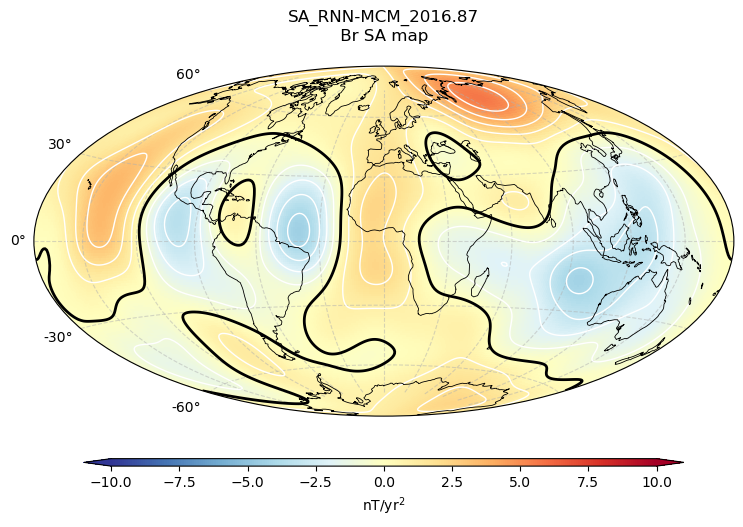

SA_RNN-MCM_2017.12
contains np.nan?  False
plot done


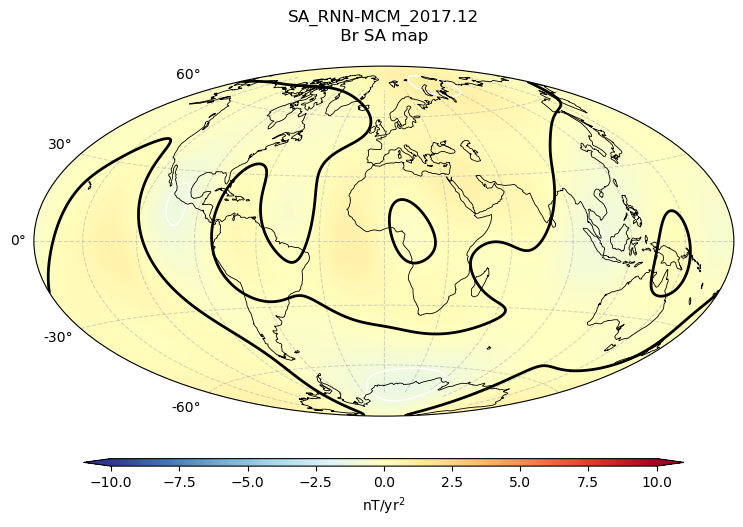

SA_RNN-MCM_2017.37
contains np.nan?  False
plot done


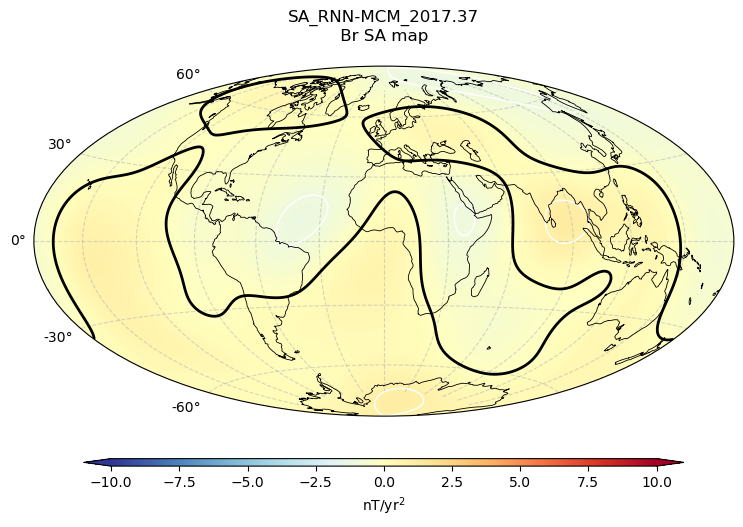

In [4]:
"""

Sixth Test: Plot a series of small maps showing the main field or SV
differences in a chosen component (default 'Z') against the other candidates

Can take several minutes depending on the machine speed

Based on the example from
https://kpegion.github.io/Pangeo-at-AOES/examples/multi-panel-cartopy.html


"""

component = 'Br'    # Choose X, Y or Z, Br, Bt, Bp


# Define the contour levels to use in plt.contourf
min_max = 10 #nT
contour = 1 # nT
clevs=np.arange(-min_max,min_max+1,contour)


# Set up a lat/long grid  every 5 degrees
max_lon = 180
max_lat = 90
num_lon = int(2 * max_lon) + 1
num_lat = int(2 * max_lat) + 1
longs  = np.linspace(-max_lon, max_lon, num_lon)
lats   = np.linspace(-max_lat, max_lat, num_lat)
RREF = 6371.2 # standard geomagnetic Earth radius (in km)


# PLOT --------------------------------------------------------------
# Use an axis counter to ensure no gaps in the middle subplots
#Loop over all of the models
for j in range(num_candidates):
    # Define the figure and each axis for the 3 rows and 3 columns
    fig, axes = plt.subplots(subplot_kw={'projection': 'hammer'},
                            figsize=(10,5), squeeze=False)

    ax = axes[0,0]
    # Compute the Gauss coefficient differences
    # skip the pos[0] model (or it will be empty)

    print(institute_name[j])
    # D. Kerridge's code includes the monopole for SHA computation
    gh = np.append(0., coeffs[:,j])

    # Compute the maps of differences and save to a dict for ease
    # of plotting an individual element
    Bx, By, Bz = zip(*[shal.shm_calculator(gh,degree,RREF, \
                                            90-lat,lon, \
                                            'Geocentric') \
                        for lat in lats for lon in longs])
    X = np.asarray(Bx).reshape(num_lat,num_lon)
    Y = np.asarray(By).reshape(num_lat,num_lon)
    Z = np.asarray(Bz).reshape(num_lat,num_lon)
    elements={'X':X, 'Y':Y, 'Z':Z, 'Br':-Z, 'Bt':-X, 'Bp':Y}

    # Filled colour plot
    cs=ax.pcolormesh(np.radians(longs), np.radians(lats),
                        elements[component],
                        cmap='RdYlBu_r',
                        vmin=clevs.min(),
                        vmax=clevs.max()
                    )

    print("contains np.nan? ", np.isnan(elements[component]).any())

    # cs = ax.contourf(np.radians(longs), np.radians(lats),
    #                  elements[component],
    #                  levels=clevs,
    #                  cmap='RdYlBu_r', extend='both') # works weirdly

    for lev in clevs:
        line_c = ax.contour(np.radians(longs), np.radians(lats),
                            elements[component],
                            levels=[lev], alpha=1.0,
                            colors=['white'], linewidths=1,
                            negative_linestyles='solid')

    # Add the zero contours
    line_c = ax.contour(np.radians(longs), np.radians(lats),
                        elements[component],
                        levels=[0], alpha=1.0,
                        colors=['black'], linewidths=2.0, 
                        linestyles='solid')
    print("plot done")

    # FORMAT --------------------------------------------------------------
    # Title each subplot with the name of the model
    ax.set_title(institute_name[j] + f"\n {component} SA map \n")

    # Draw the coastines for each subplot
    # read shape-file and plot coast lines
    with shapefile.Reader(shp) as sf:

        for rec in sf.shapeRecords():
            lon_coast = np.radians([point[0] for point in rec.shape.points[:]])
            lat_coast = np.radians([point[1] for point in rec.shape.points[:]])

            ax.plot(lon_coast, lat_coast, color='k', linewidth=0.6, alpha=1.0)


    ax.xaxis.set_ticks(np.radians(np.linspace(-180., 180., num=13)))  # meridians
    ax.yaxis.set_ticks(np.radians(np.linspace(-60., 60., num=5)))  # parallels
    ax.xaxis.set_major_formatter('')  # remove labels from meridians
    ax.grid(True, linestyle='--', alpha=0.5)

    # plt.suptitle('Br SV map')

    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.05, right=0.95,
                        wspace=0.1, hspace=0.5)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.015])

    # Draw the colorbar
    cbar=fig.colorbar(cs, cax=cbar_ax,orientation='horizontal', label=r'nT/yr$^2$', extend='both')

    plt.savefig(f'./SA_gap_cofs/{institute_name[j]}_{component}.png', dpi=300)
    plt.show()

SA_LOD-MCM_2014.12
contains np.nan?  False
plot done


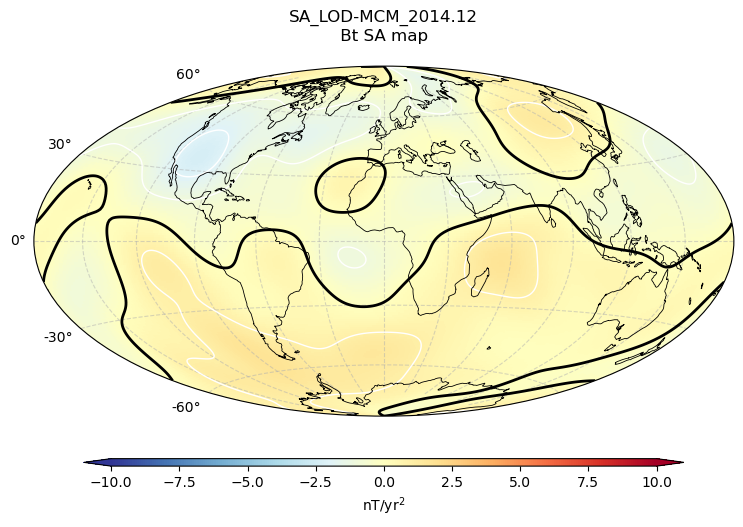

SA_LOD-MCM_2014.37
contains np.nan?  False
plot done


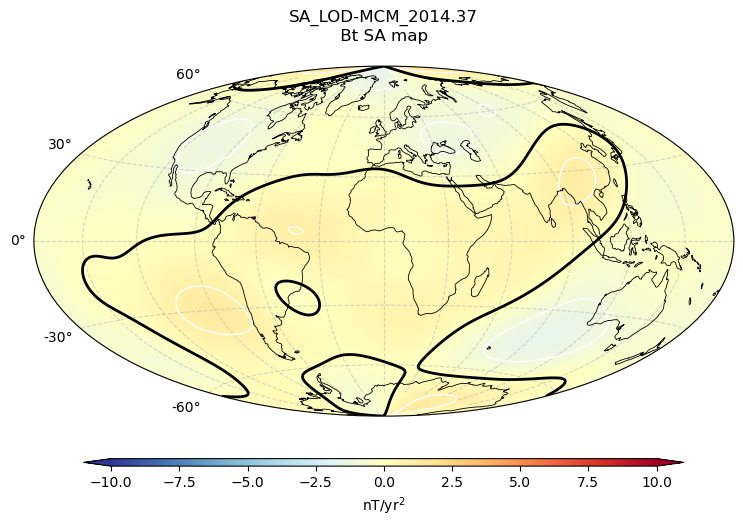

SA_LOD-MCM_2014.62
contains np.nan?  False
plot done


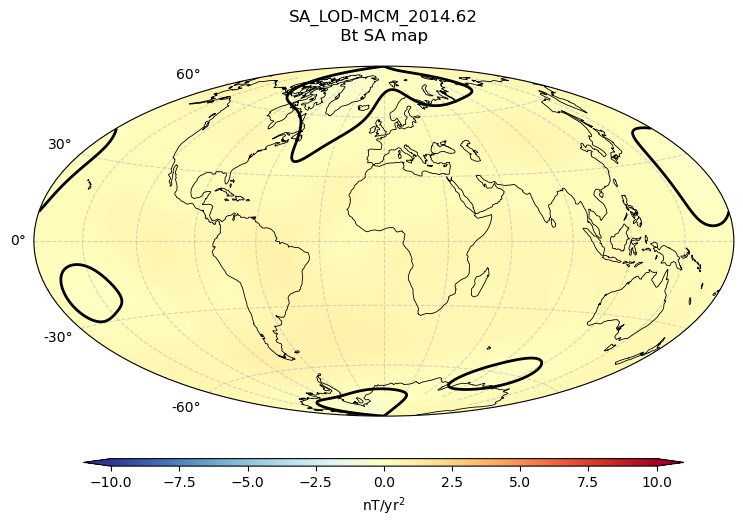

SA_LOD-MCM_2014.87
contains np.nan?  False
plot done


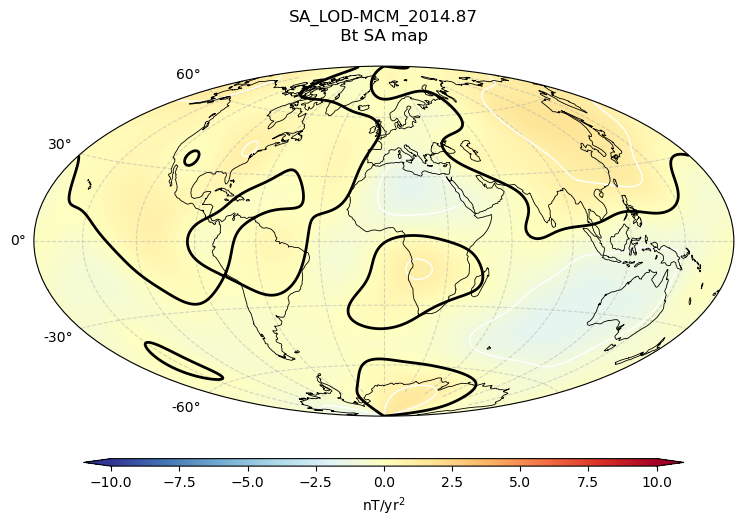

SA_LOD-MCM_2015.13
contains np.nan?  False
plot done


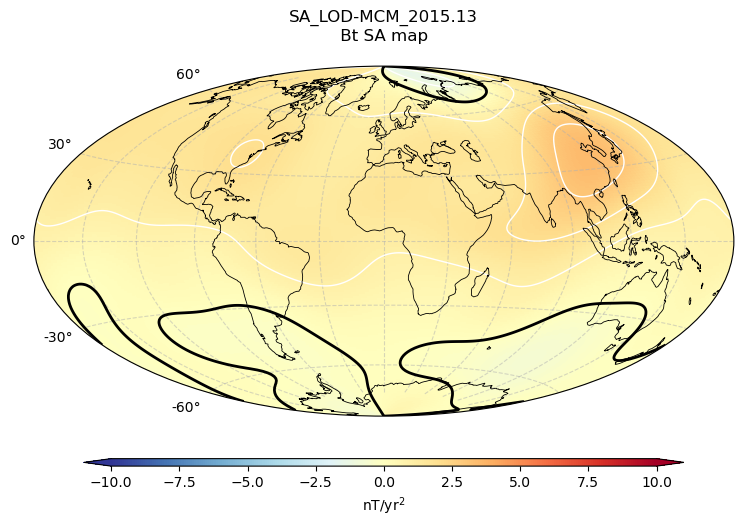

SA_LOD-MCM_2015.38
contains np.nan?  False
plot done


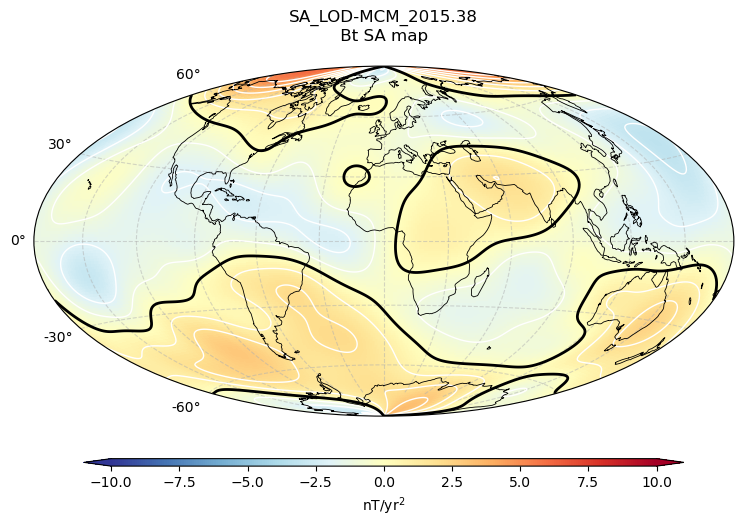

SA_LOD-MCM_2015.63
contains np.nan?  False
plot done


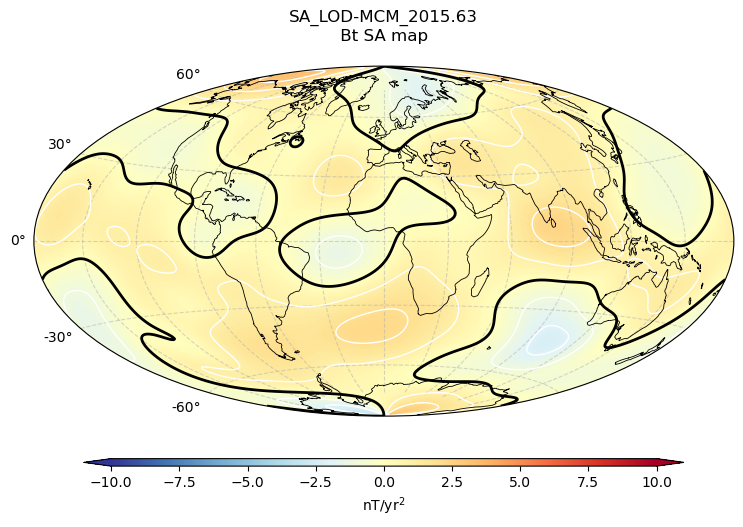

SA_LOD-MCM_2015.88
contains np.nan?  False
plot done


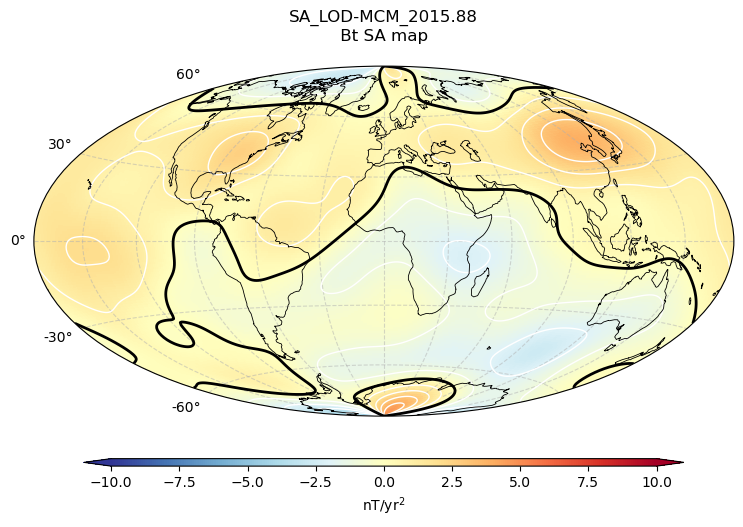

SA_LOD-MCM_2016.12
contains np.nan?  False
plot done


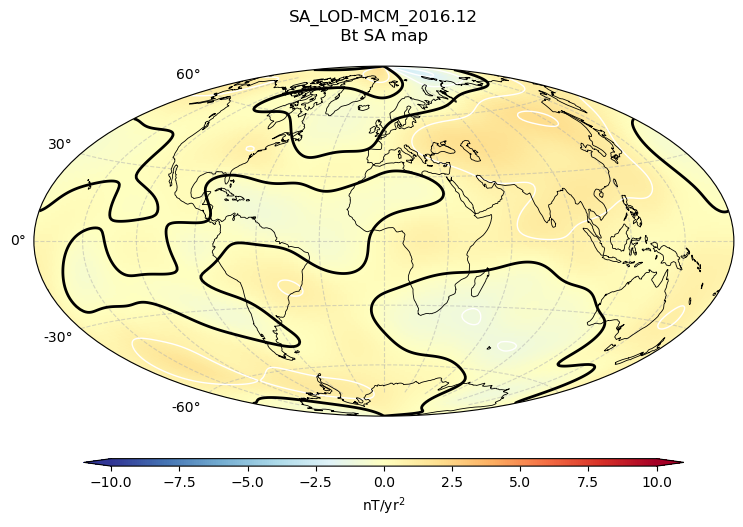

SA_LOD-MCM_2016.37
contains np.nan?  False
plot done


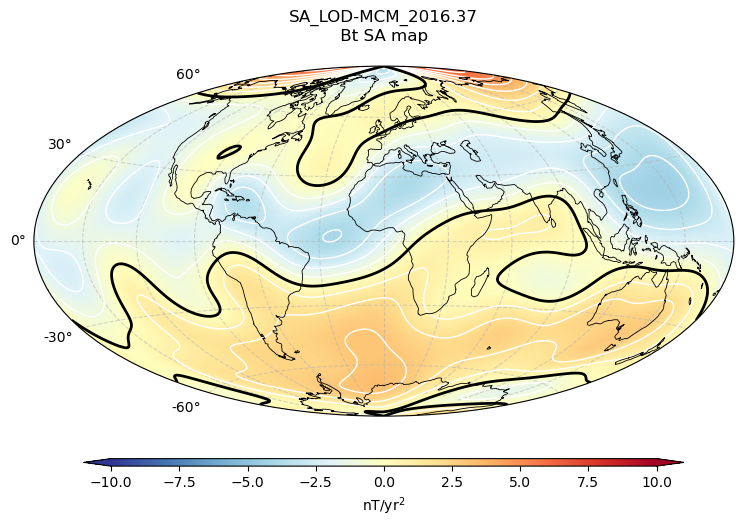

SA_LOD-MCM_2016.62
contains np.nan?  False
plot done


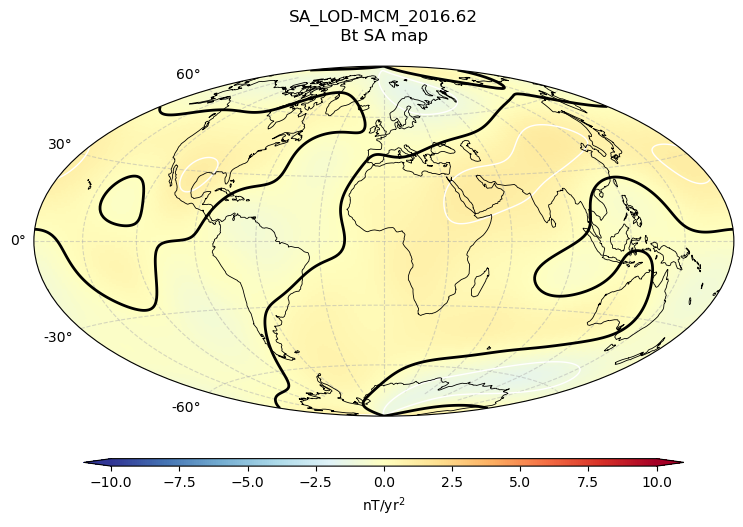

SA_LOD-MCM_2016.87
contains np.nan?  False
plot done


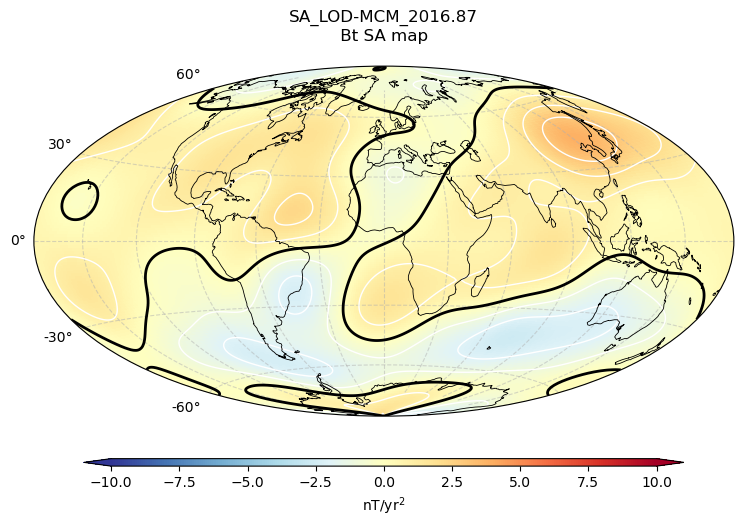

SA_LOD-MCM_2017.12
contains np.nan?  False
plot done


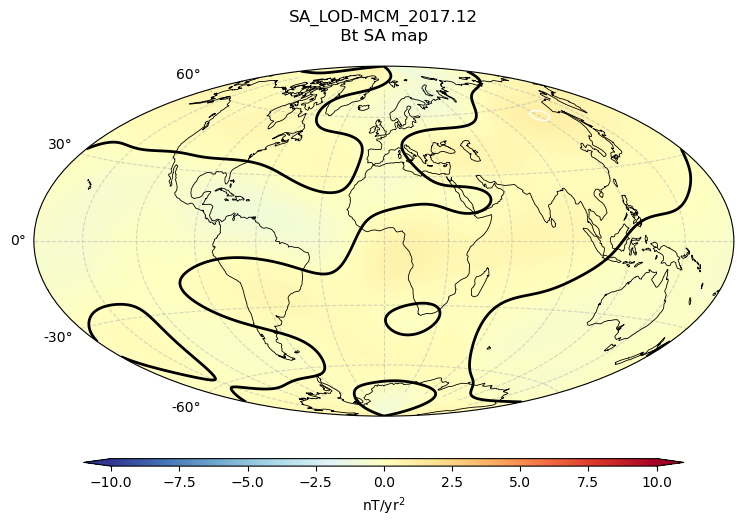

SA_LOD-MCM_2017.37
contains np.nan?  False
plot done


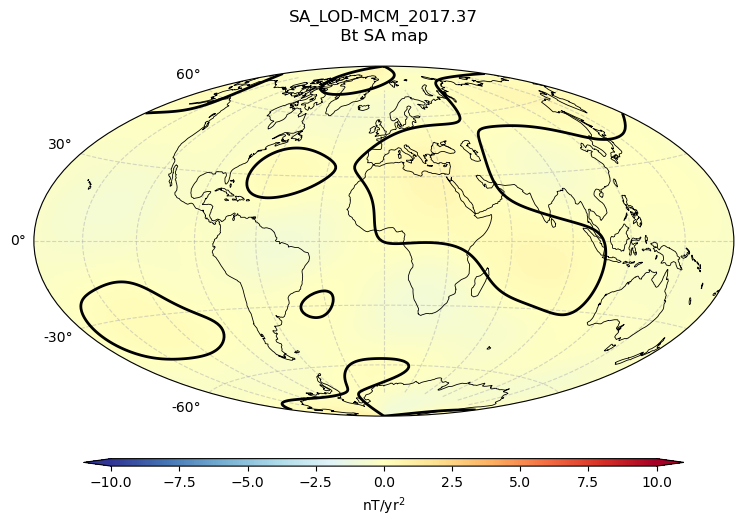

SA_LOD-RNN_2014.12
contains np.nan?  False
plot done


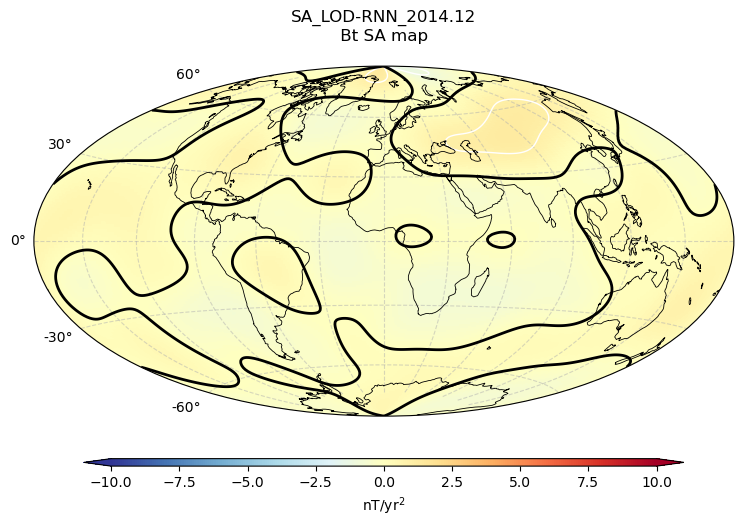

SA_LOD-RNN_2014.37
contains np.nan?  False
plot done


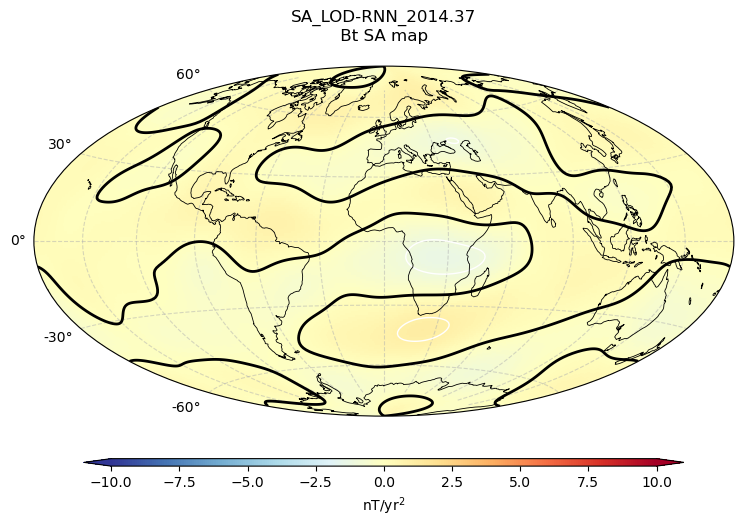

SA_LOD-RNN_2014.62
contains np.nan?  False
plot done


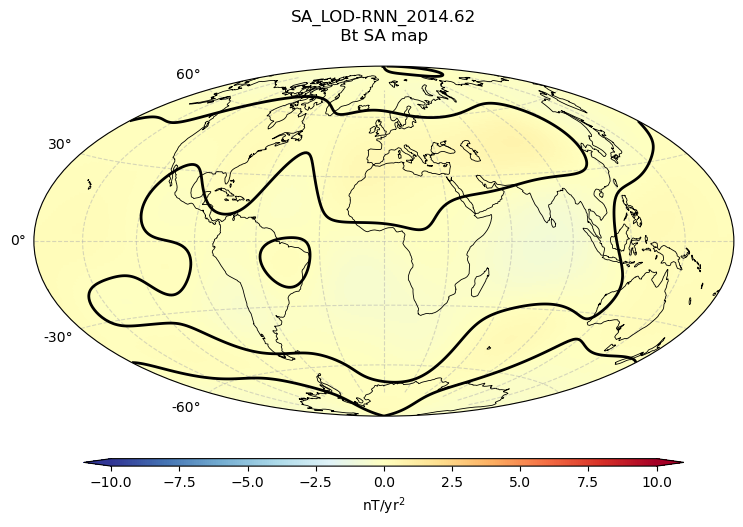

SA_LOD-RNN_2014.87
contains np.nan?  False
plot done


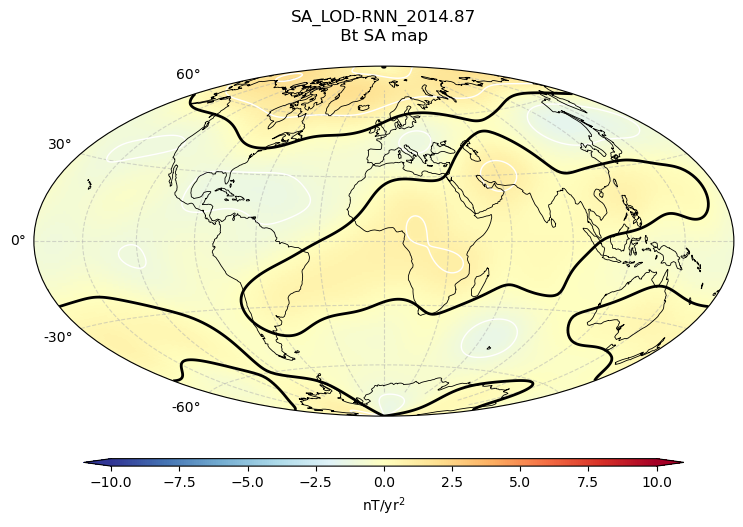

SA_LOD-RNN_2015.13
contains np.nan?  False
plot done


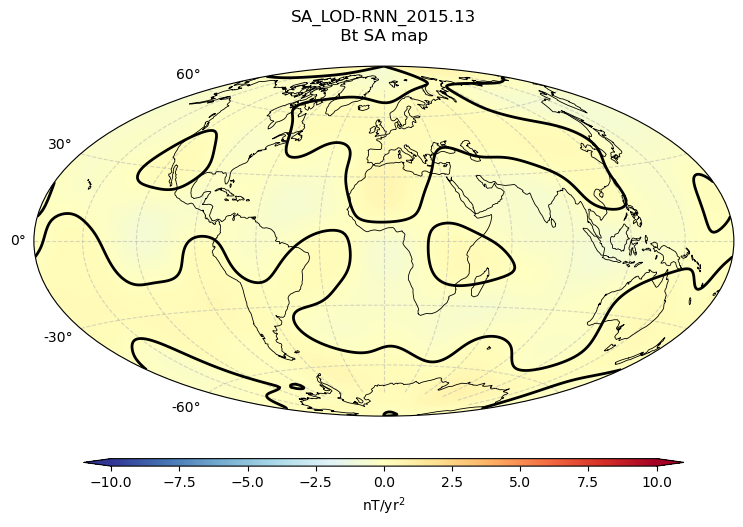

SA_LOD-RNN_2015.38
contains np.nan?  False
plot done


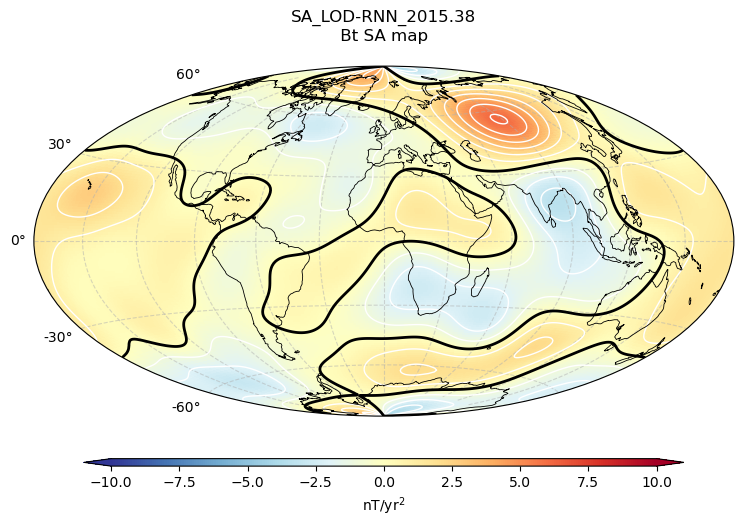

SA_LOD-RNN_2015.63
contains np.nan?  False
plot done


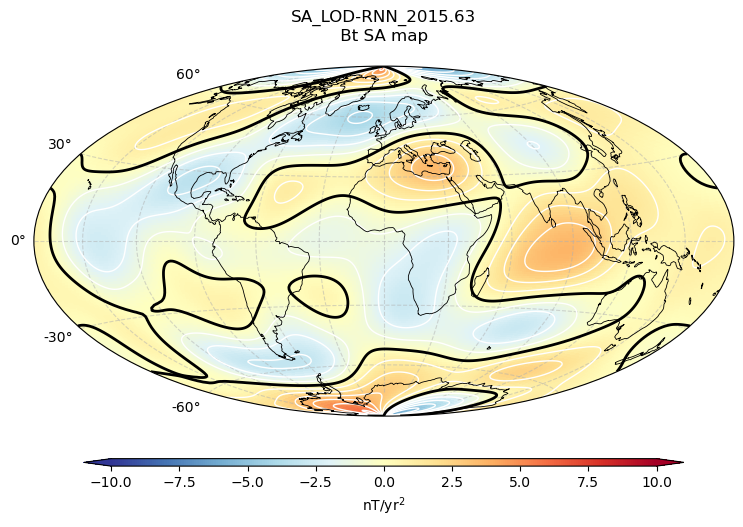

SA_LOD-RNN_2015.88
contains np.nan?  False
plot done


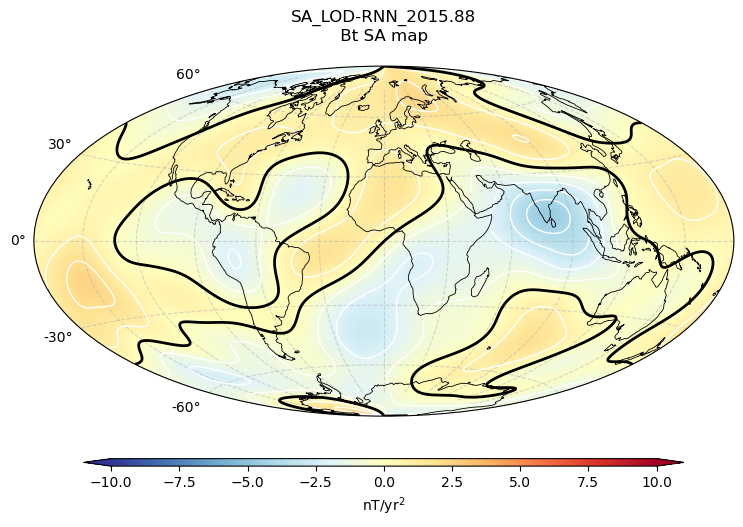

SA_LOD-RNN_2016.12
contains np.nan?  False
plot done


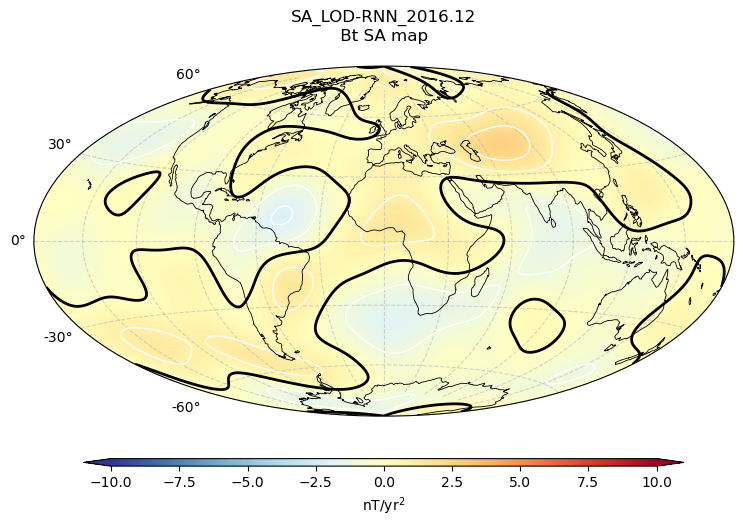

SA_LOD-RNN_2016.37
contains np.nan?  False
plot done


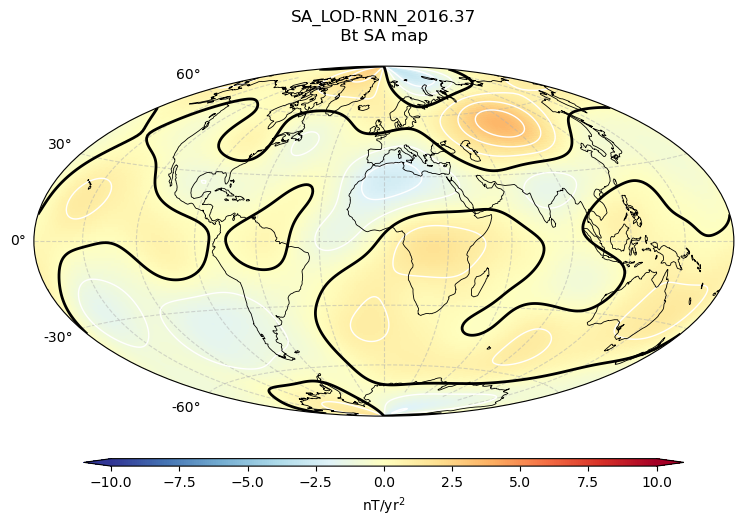

SA_LOD-RNN_2016.62
contains np.nan?  False
plot done


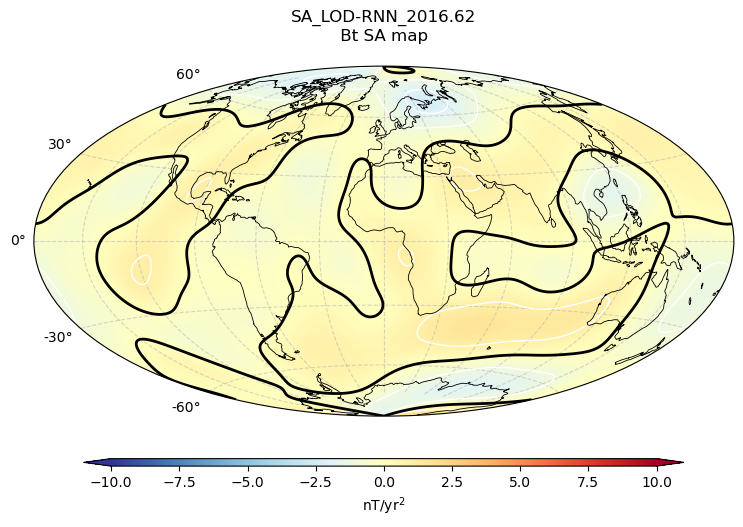

SA_LOD-RNN_2016.87
contains np.nan?  False
plot done


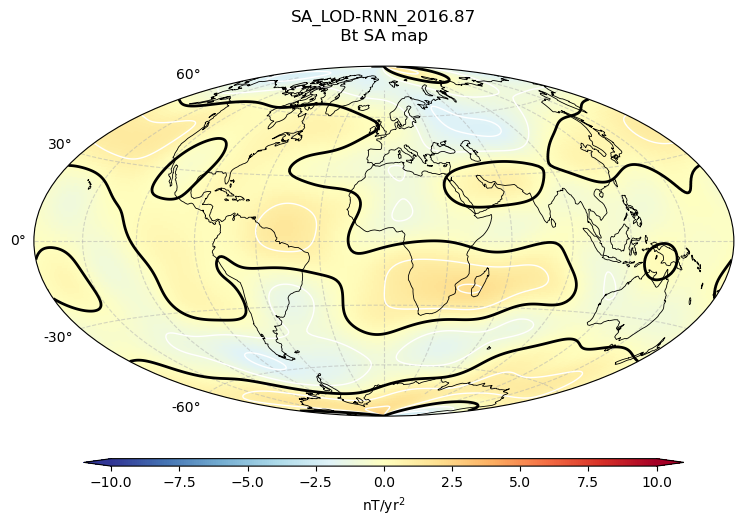

SA_LOD-RNN_2017.12
contains np.nan?  False
plot done


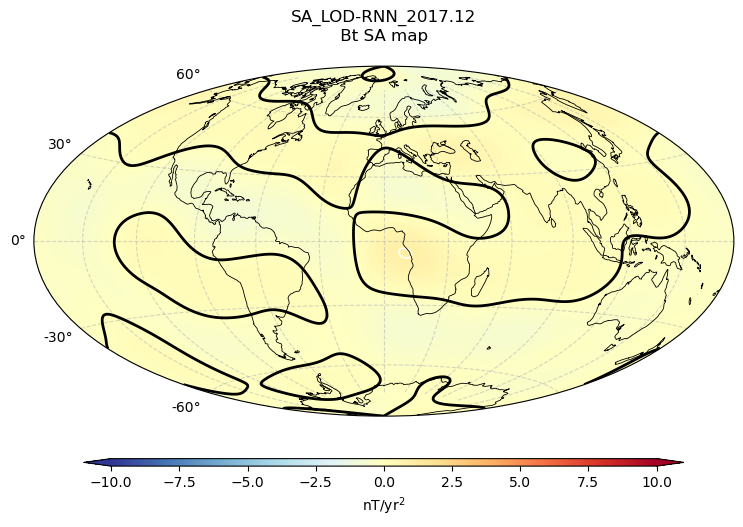

SA_LOD-RNN_2017.37
contains np.nan?  False
plot done


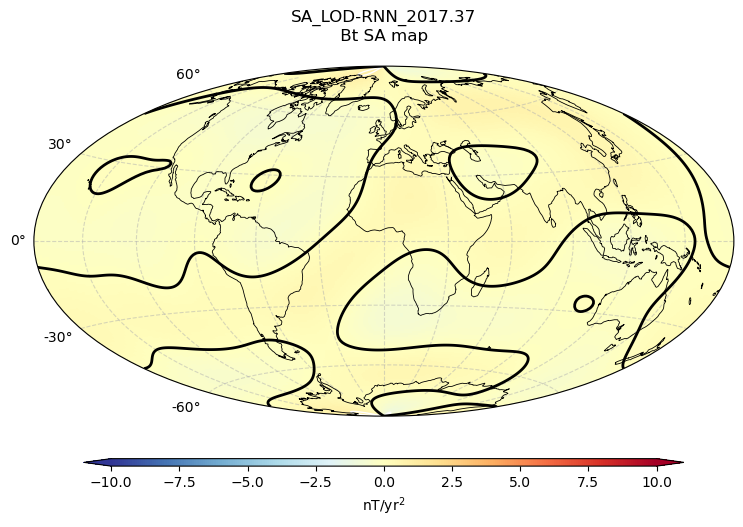

SA_RNN-MCM_2014.12
contains np.nan?  False
plot done


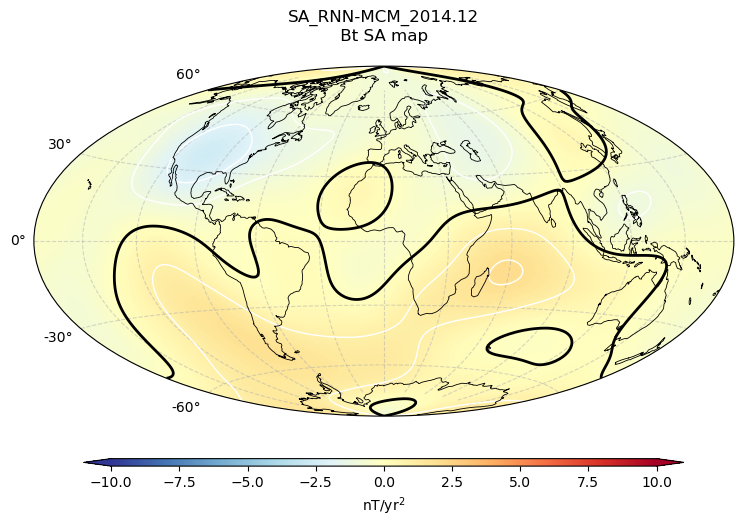

SA_RNN-MCM_2014.37
contains np.nan?  False
plot done


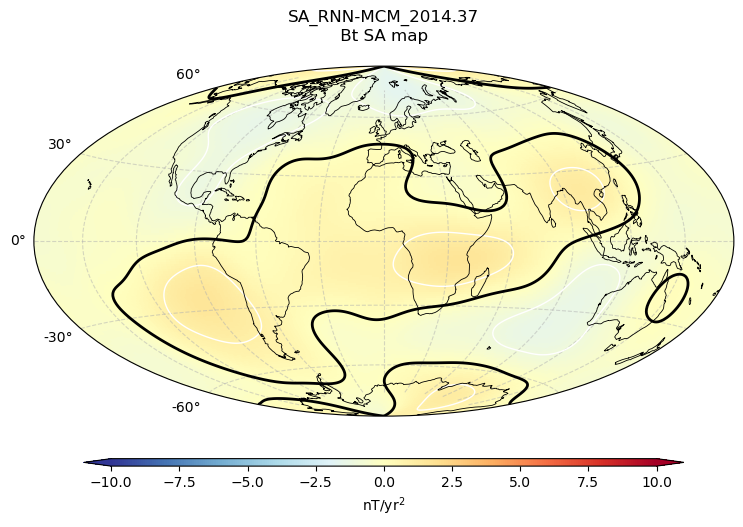

SA_RNN-MCM_2014.62
contains np.nan?  False
plot done


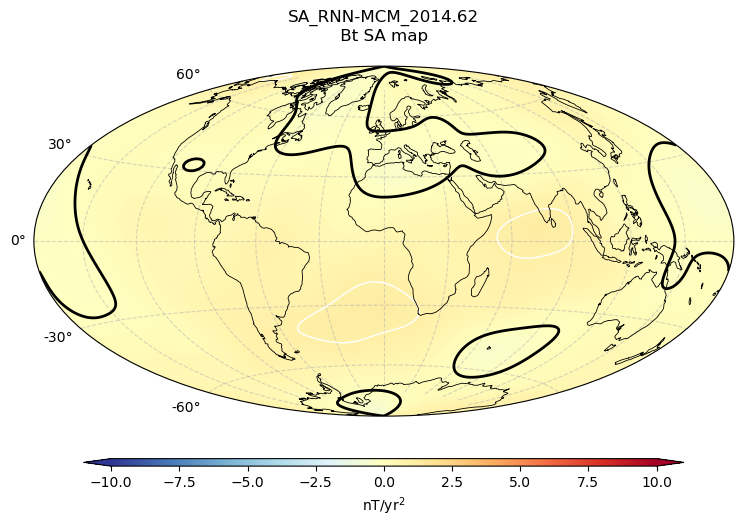

SA_RNN-MCM_2014.87
contains np.nan?  False
plot done


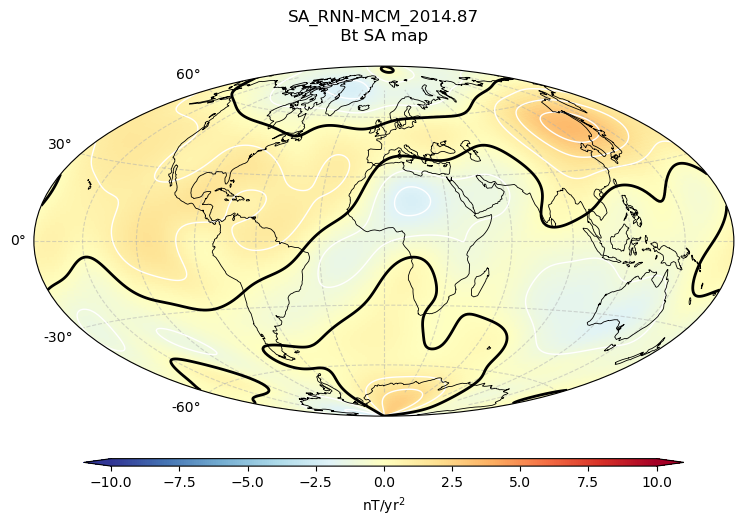

SA_RNN-MCM_2015.13
contains np.nan?  False
plot done


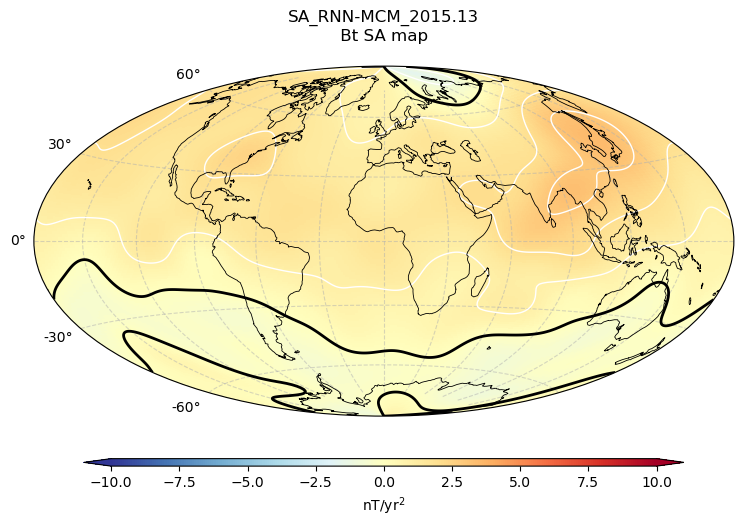

SA_RNN-MCM_2015.38
contains np.nan?  False
plot done


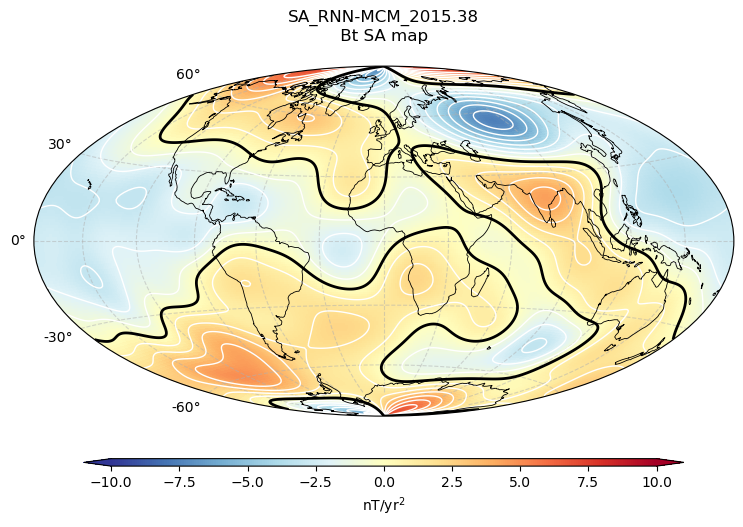

SA_RNN-MCM_2015.63
contains np.nan?  False
plot done


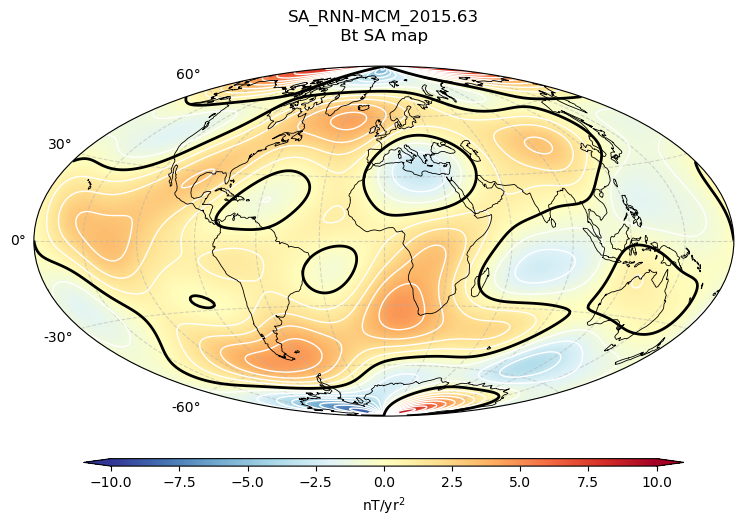

SA_RNN-MCM_2015.88
contains np.nan?  False
plot done


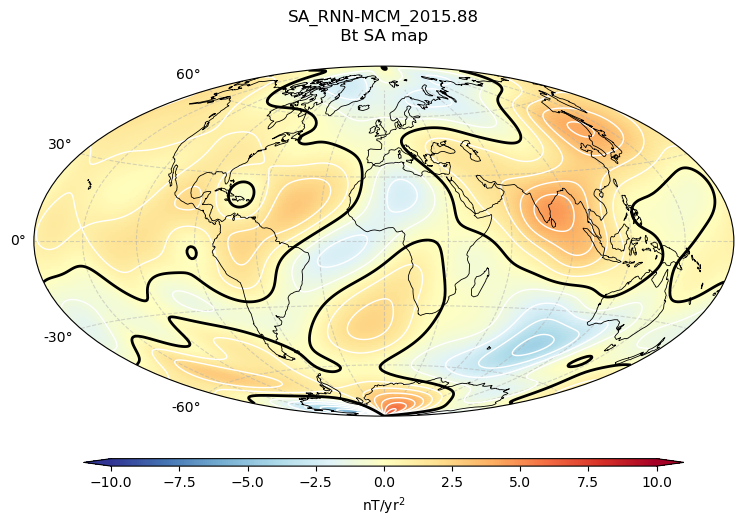

SA_RNN-MCM_2016.12
contains np.nan?  False
plot done


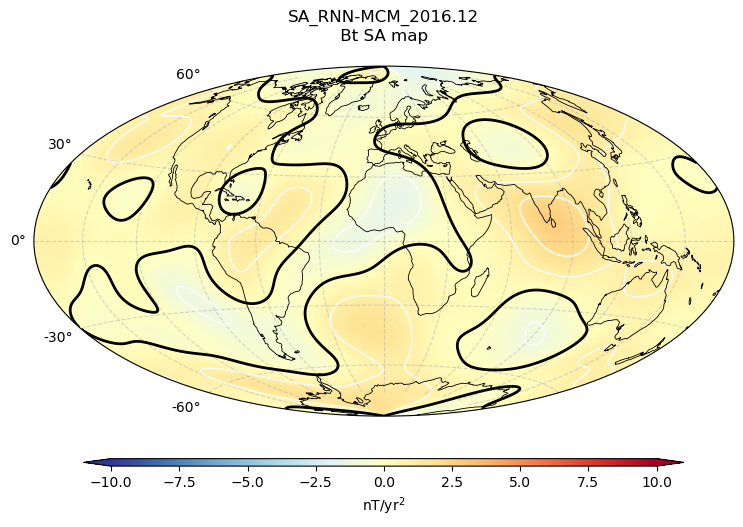

SA_RNN-MCM_2016.37
contains np.nan?  False
plot done


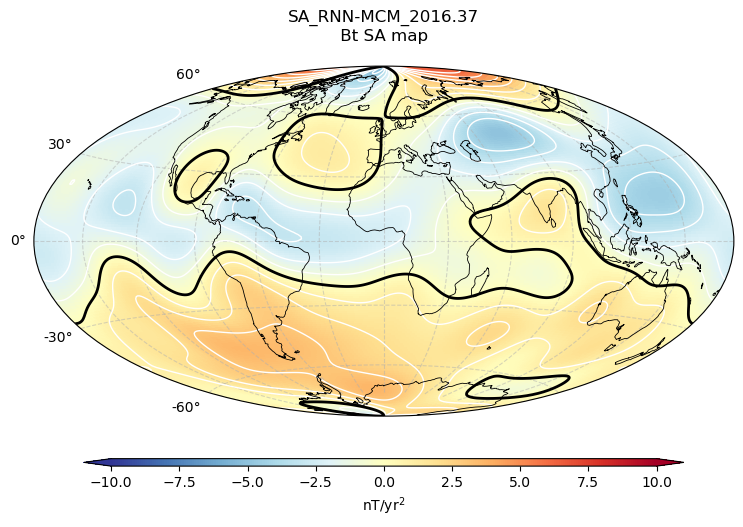

SA_RNN-MCM_2016.62
contains np.nan?  False
plot done


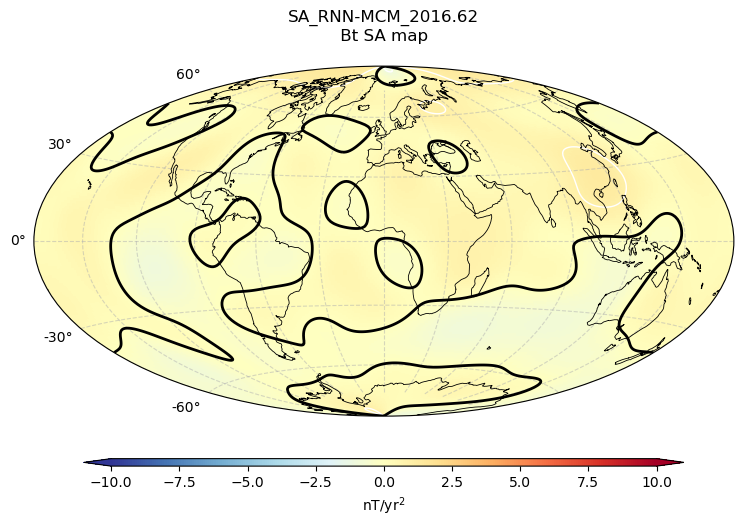

SA_RNN-MCM_2016.87
contains np.nan?  False
plot done


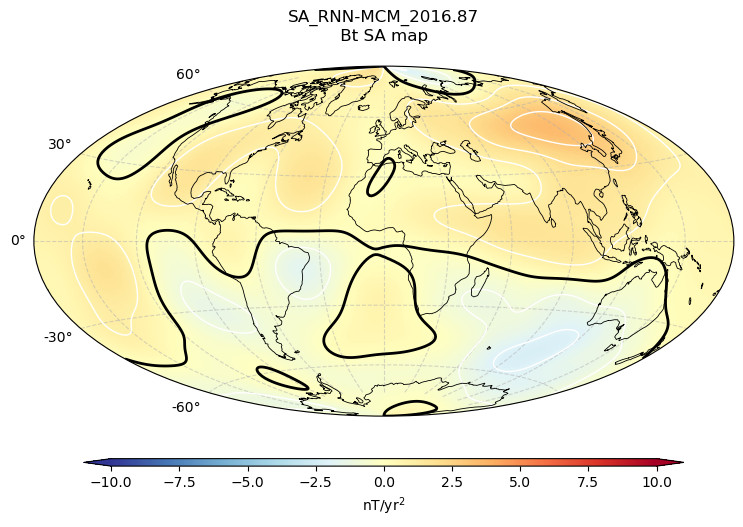

SA_RNN-MCM_2017.12
contains np.nan?  False
plot done


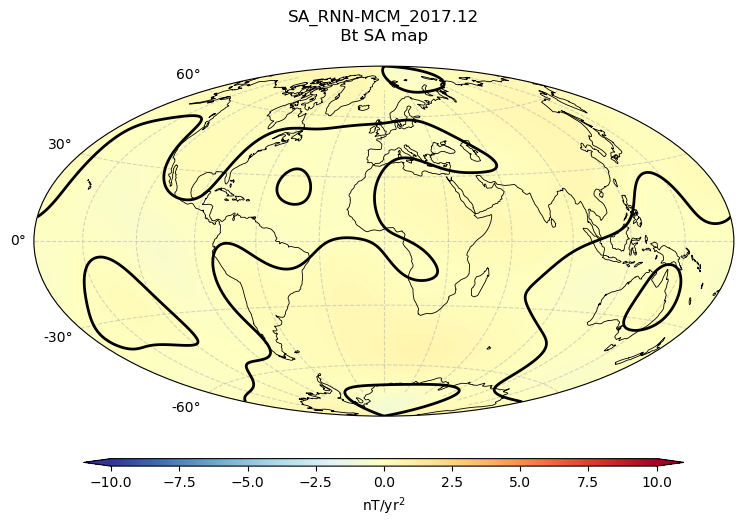

SA_RNN-MCM_2017.37
contains np.nan?  False
plot done


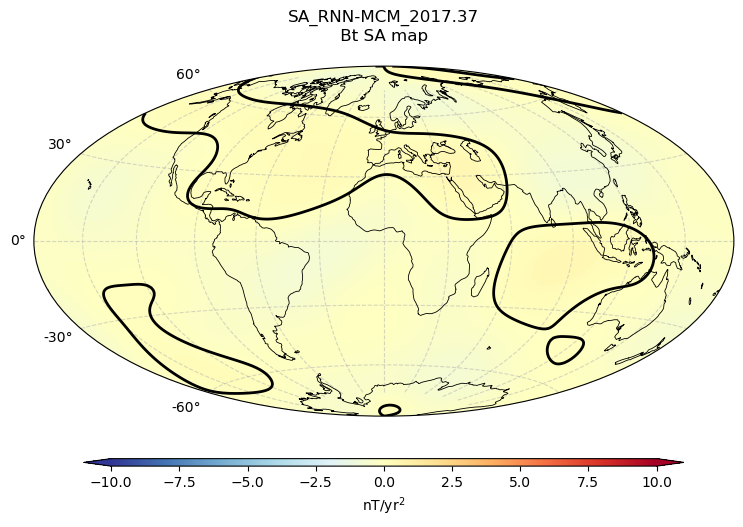

In [5]:
"""

Sixth Test: Plot a series of small maps showing the main field or SV
differences in a chosen component (default 'Z') against the other candidates

Can take several minutes depending on the machine speed

Based on the example from
https://kpegion.github.io/Pangeo-at-AOES/examples/multi-panel-cartopy.html


"""

component = 'Bt'    # Choose X, Y or Z, Br, Bt, Bp


# Define the contour levels to use in plt.contourf
min_max = 10 #nT
contour = 1 # nT
clevs=np.arange(-min_max,min_max+1,contour)


# Set up a lat/long grid  every 5 degrees
max_lon = 180
max_lat = 90
num_lon = int(2 * max_lon) + 1
num_lat = int(2 * max_lat) + 1
longs  = np.linspace(-max_lon, max_lon, num_lon)
lats   = np.linspace(-max_lat, max_lat, num_lat)
RREF = 6371.2 # standard geomagnetic Earth radius (in km)


# PLOT --------------------------------------------------------------
# Use an axis counter to ensure no gaps in the middle subplots
#Loop over all of the models
for j in range(num_candidates):
    # Define the figure and each axis for the 3 rows and 3 columns
    fig, axes = plt.subplots(subplot_kw={'projection': 'hammer'},
                            figsize=(10,5), squeeze=False)

    ax = axes[0,0]
    # Compute the Gauss coefficient differences
    # skip the pos[0] model (or it will be empty)

    print(institute_name[j])
    # D. Kerridge's code includes the monopole for SHA computation
    gh = np.append(0., coeffs[:,j])

    # Compute the maps of differences and save to a dict for ease
    # of plotting an individual element
    Bx, By, Bz = zip(*[shal.shm_calculator(gh,degree,RREF, \
                                            90-lat,lon, \
                                            'Geocentric') \
                        for lat in lats for lon in longs])
    X = np.asarray(Bx).reshape(num_lat,num_lon)
    Y = np.asarray(By).reshape(num_lat,num_lon)
    Z = np.asarray(Bz).reshape(num_lat,num_lon)
    elements={'X':X, 'Y':Y, 'Z':Z, 'Br':-Z, 'Bt':-X, 'Bp':Y}

    # Filled colour plot
    cs=ax.pcolormesh(np.radians(longs), np.radians(lats),
                        elements[component],
                        cmap='RdYlBu_r',
                        vmin=clevs.min(),
                        vmax=clevs.max()
                    )

    print("contains np.nan? ", np.isnan(elements[component]).any())

    # cs = ax.contourf(np.radians(longs), np.radians(lats),
    #                  elements[component],
    #                  levels=clevs,
    #                  cmap='RdYlBu_r', extend='both') # works weirdly

    for lev in clevs:
        line_c = ax.contour(np.radians(longs), np.radians(lats),
                            elements[component],
                            levels=[lev], alpha=1.0,
                            colors=['white'], linewidths=1,
                            negative_linestyles='solid')

    # Add the zero contours
    line_c = ax.contour(np.radians(longs), np.radians(lats),
                        elements[component],
                        levels=[0], alpha=1.0,
                        colors=['black'], linewidths=2.0, 
                        linestyles='solid')
    print("plot done")

    # FORMAT --------------------------------------------------------------
    # Title each subplot with the name of the model
    ax.set_title(institute_name[j] + f"\n {component} SA map \n")

    # Draw the coastines for each subplot
    # read shape-file and plot coast lines
    with shapefile.Reader(shp) as sf:

        for rec in sf.shapeRecords():
            lon_coast = np.radians([point[0] for point in rec.shape.points[:]])
            lat_coast = np.radians([point[1] for point in rec.shape.points[:]])

            ax.plot(lon_coast, lat_coast, color='k', linewidth=0.6, alpha=1.0)


    ax.xaxis.set_ticks(np.radians(np.linspace(-180., 180., num=13)))  # meridians
    ax.yaxis.set_ticks(np.radians(np.linspace(-60., 60., num=5)))  # parallels
    ax.xaxis.set_major_formatter('')  # remove labels from meridians
    ax.grid(True, linestyle='--', alpha=0.5)

    # plt.suptitle('Br SV map')

    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.05, right=0.95,
                        wspace=0.1, hspace=0.5)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.015])

    # Draw the colorbar
    cbar=fig.colorbar(cs, cax=cbar_ax,orientation='horizontal', label=r'nT/yr$^2$', extend='both')

    plt.savefig(f'./SA_gap_cofs/{institute_name[j]}_{component}.png', dpi=300)
    plt.show()

SA_LOD-MCM_2014.12
contains np.nan?  False
plot done


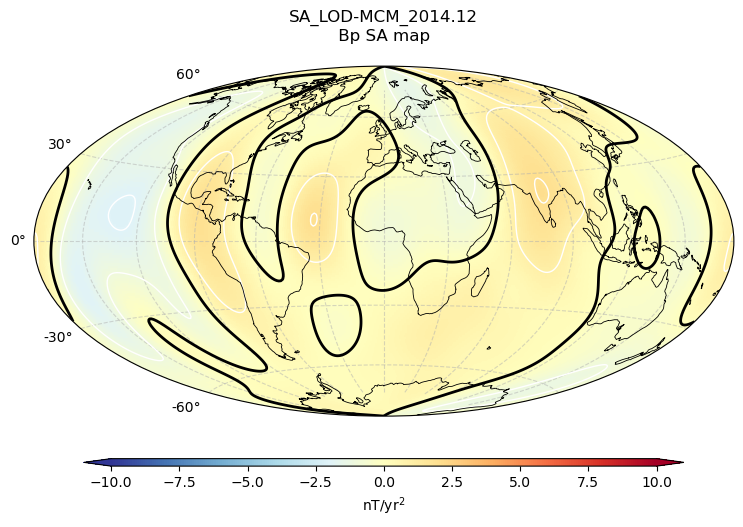

SA_LOD-MCM_2014.37
contains np.nan?  False
plot done


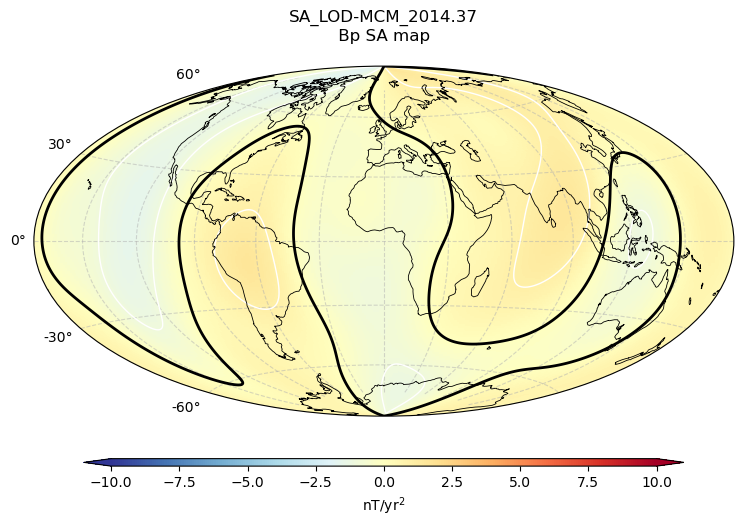

SA_LOD-MCM_2014.62
contains np.nan?  False
plot done


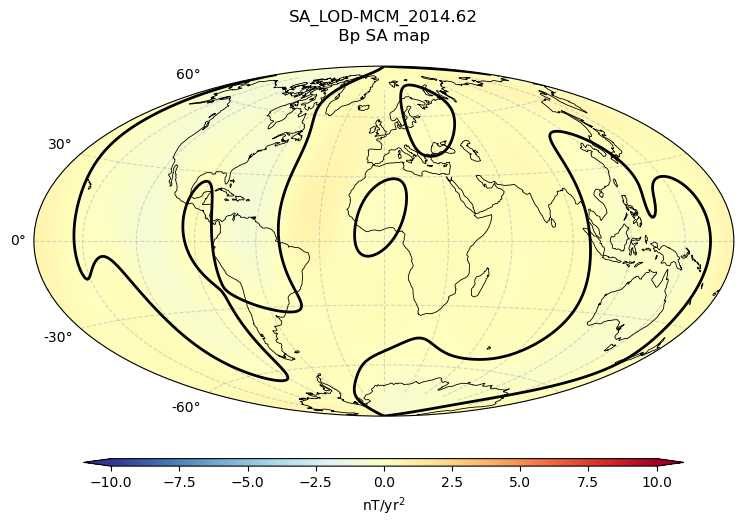

SA_LOD-MCM_2014.87
contains np.nan?  False
plot done


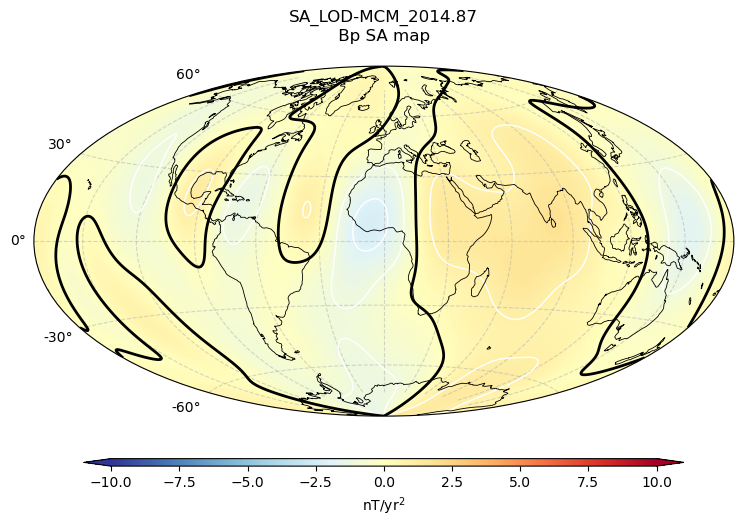

SA_LOD-MCM_2015.13
contains np.nan?  False
plot done


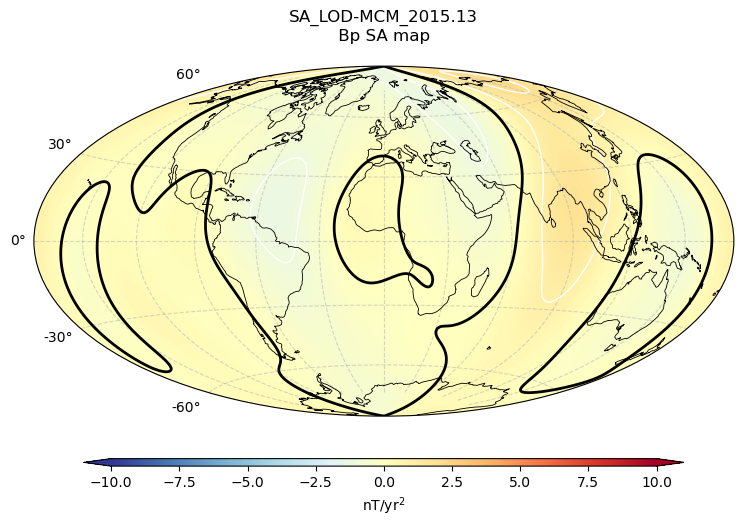

SA_LOD-MCM_2015.38
contains np.nan?  False
plot done


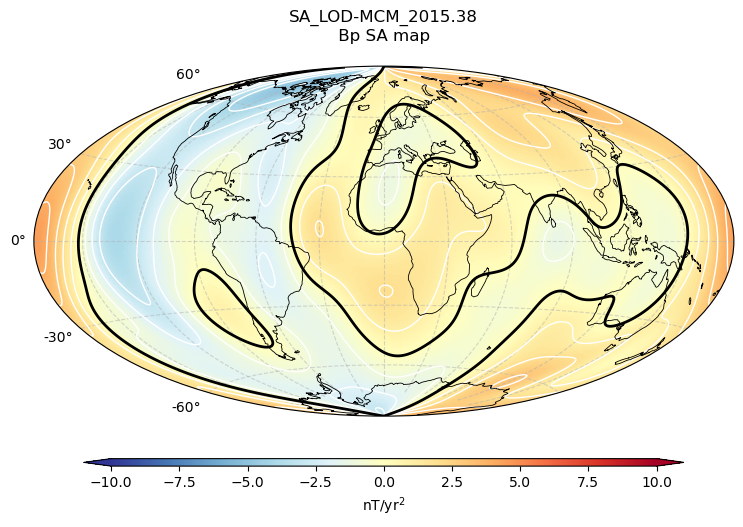

SA_LOD-MCM_2015.63
contains np.nan?  False
plot done


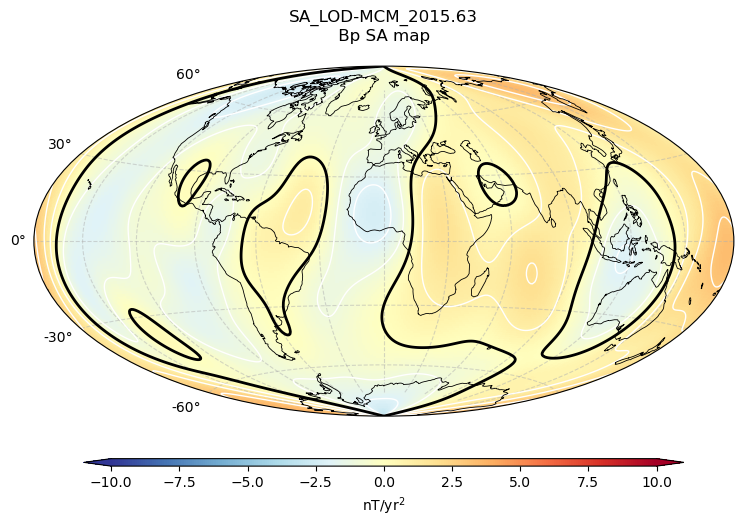

SA_LOD-MCM_2015.88
contains np.nan?  False
plot done


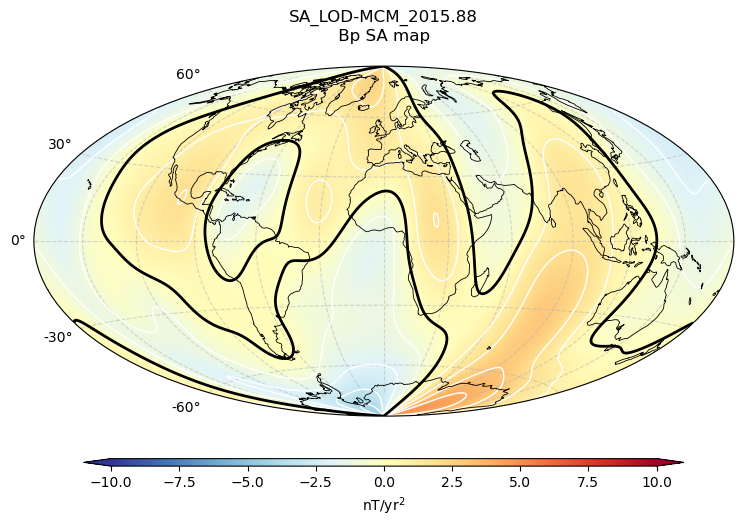

SA_LOD-MCM_2016.12
contains np.nan?  False
plot done


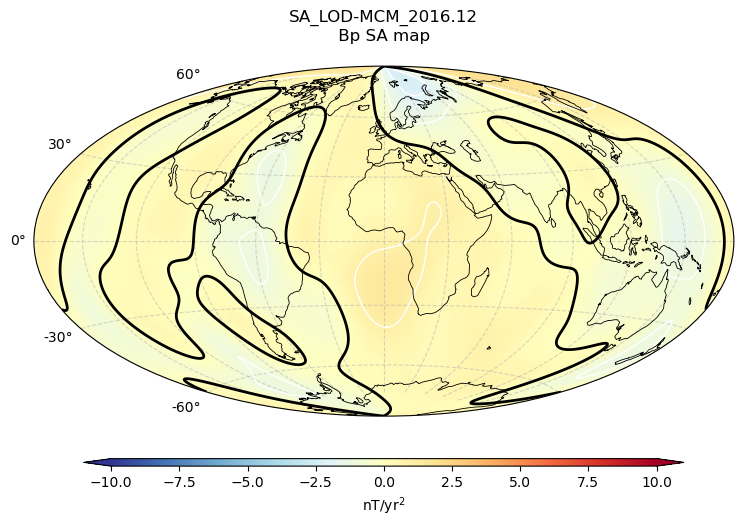

SA_LOD-MCM_2016.37
contains np.nan?  False
plot done


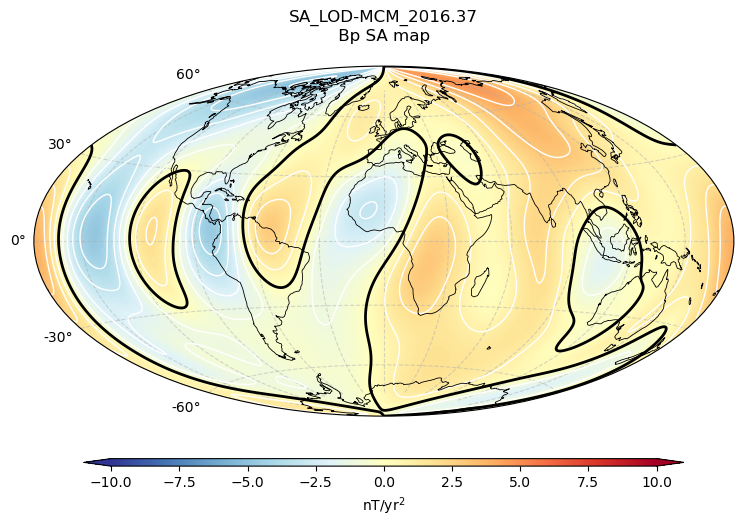

SA_LOD-MCM_2016.62
contains np.nan?  False
plot done


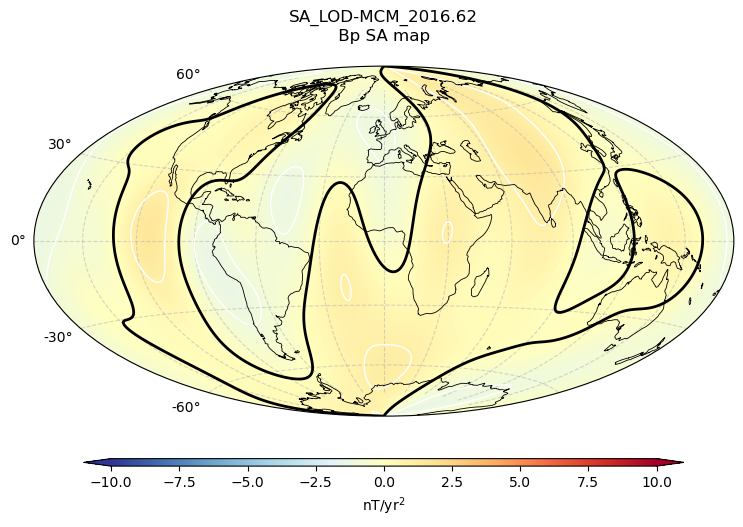

SA_LOD-MCM_2016.87
contains np.nan?  False
plot done


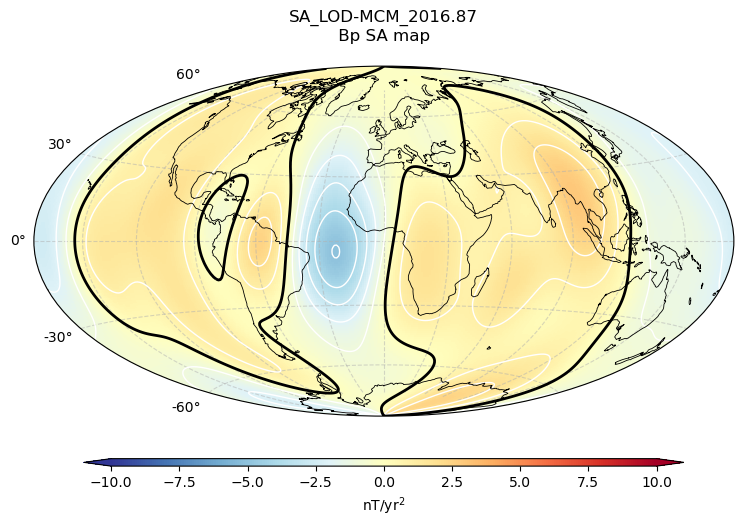

SA_LOD-MCM_2017.12
contains np.nan?  False
plot done


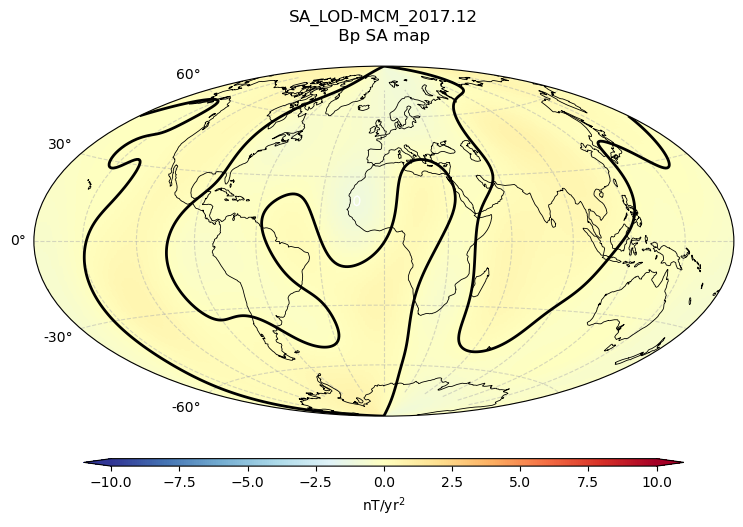

SA_LOD-MCM_2017.37
contains np.nan?  False
plot done


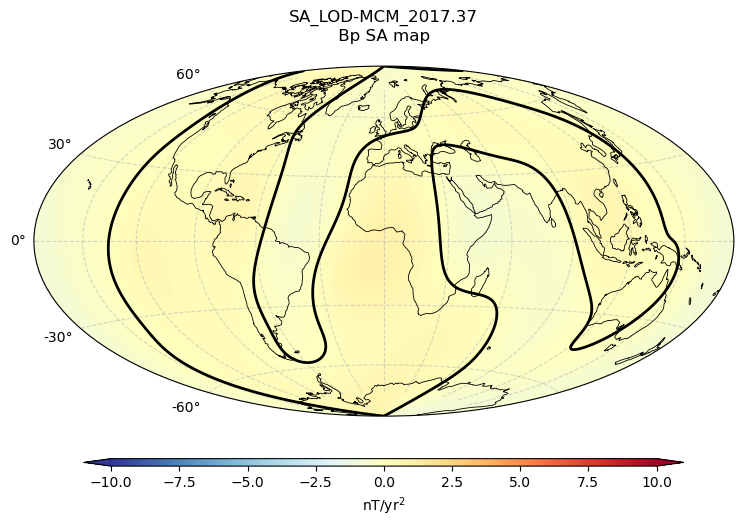

SA_LOD-RNN_2014.12
contains np.nan?  False
plot done


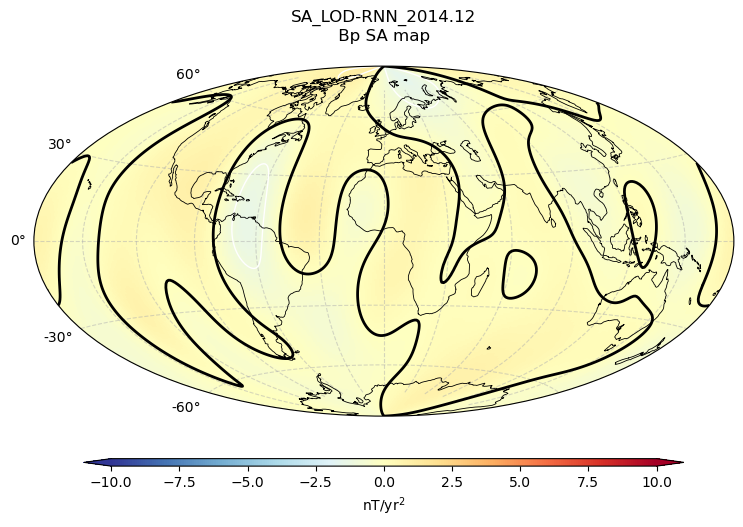

SA_LOD-RNN_2014.37
contains np.nan?  False
plot done


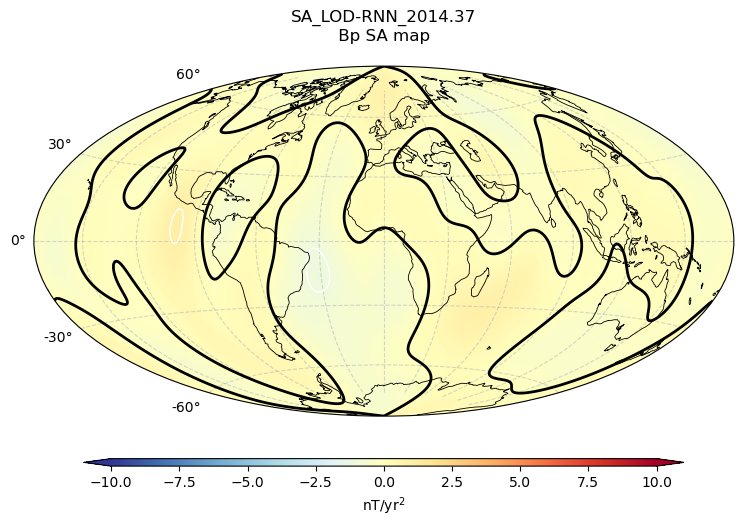

SA_LOD-RNN_2014.62
contains np.nan?  False
plot done


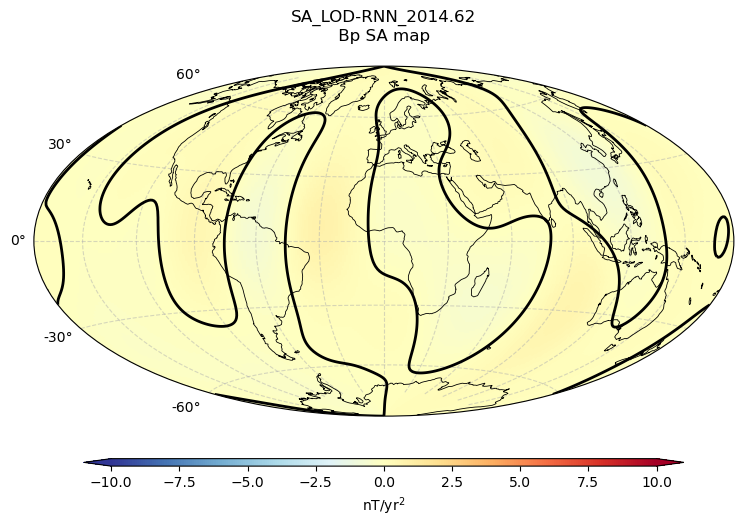

SA_LOD-RNN_2014.87
contains np.nan?  False
plot done


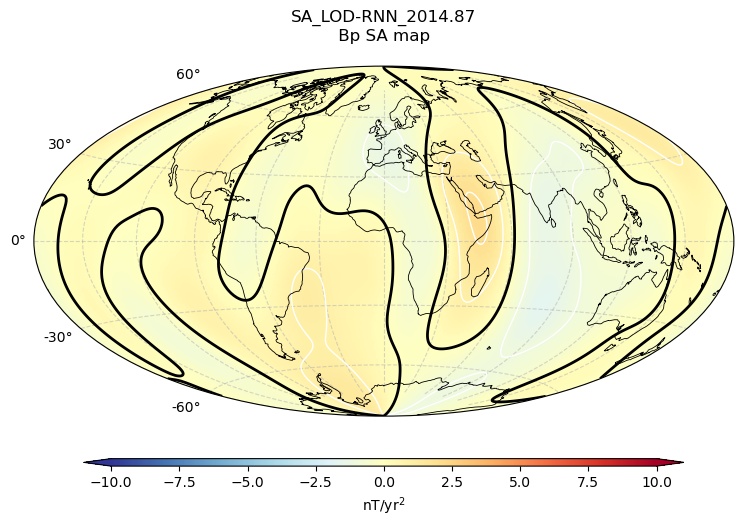

SA_LOD-RNN_2015.13
contains np.nan?  False
plot done


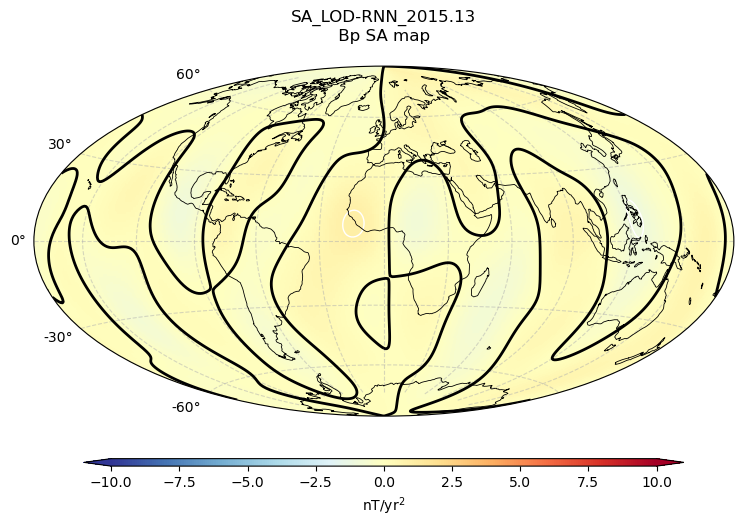

SA_LOD-RNN_2015.38
contains np.nan?  False
plot done


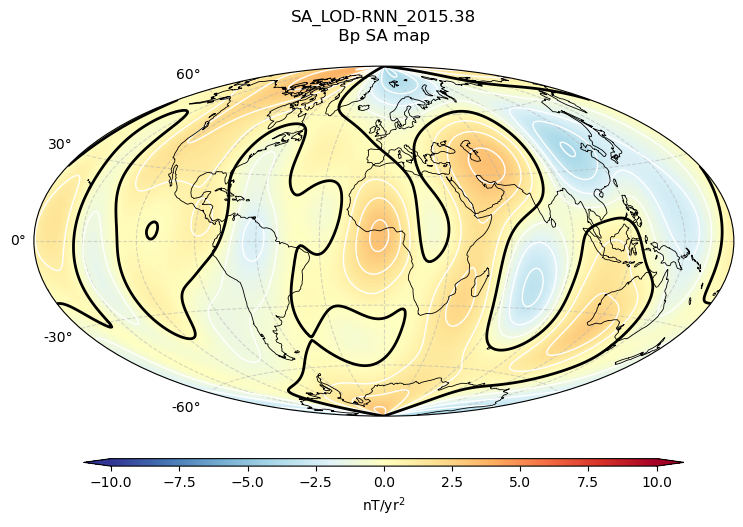

SA_LOD-RNN_2015.63
contains np.nan?  False
plot done


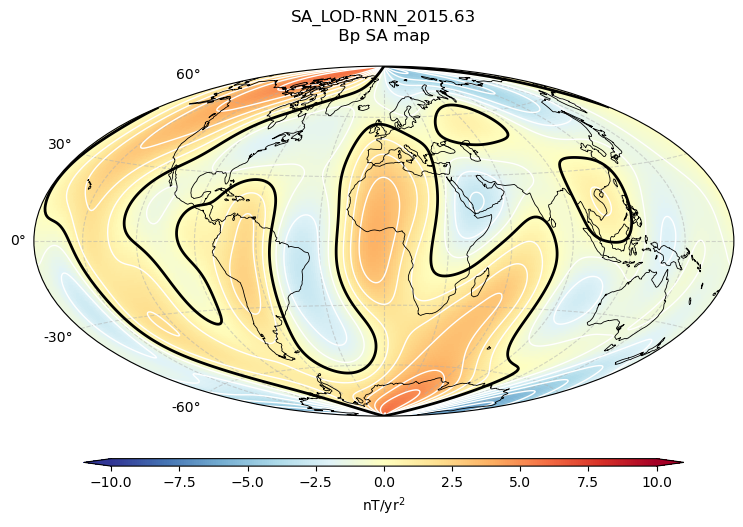

SA_LOD-RNN_2015.88
contains np.nan?  False
plot done


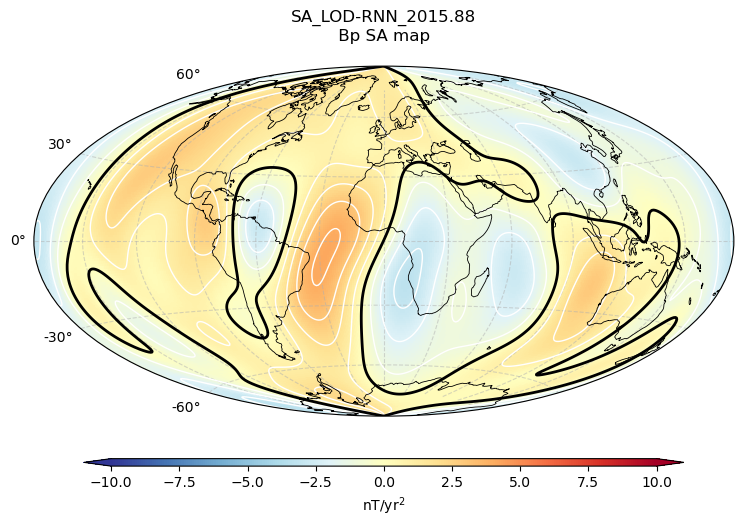

SA_LOD-RNN_2016.12
contains np.nan?  False
plot done


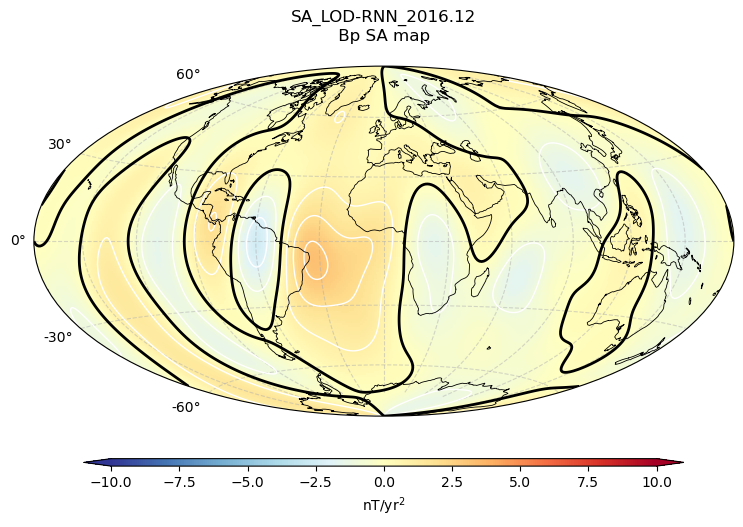

SA_LOD-RNN_2016.37
contains np.nan?  False
plot done


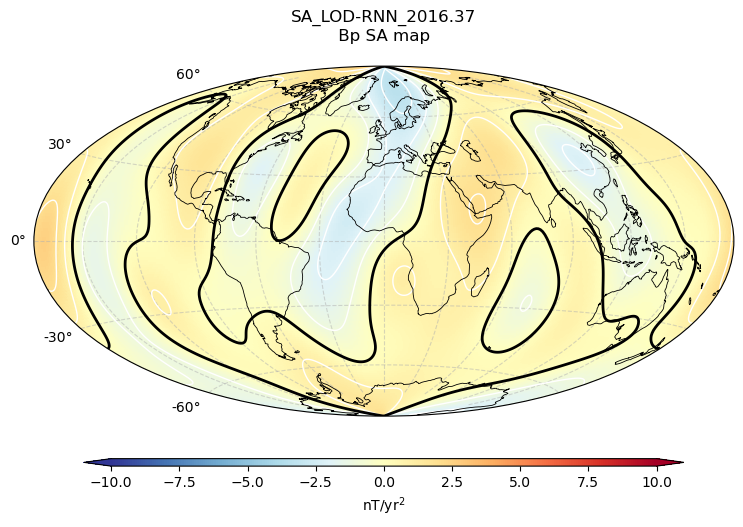

SA_LOD-RNN_2016.62
contains np.nan?  False
plot done


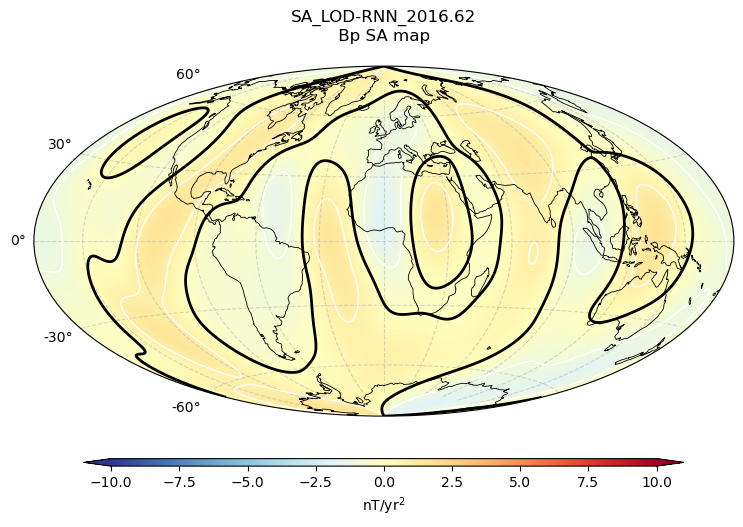

SA_LOD-RNN_2016.87
contains np.nan?  False
plot done


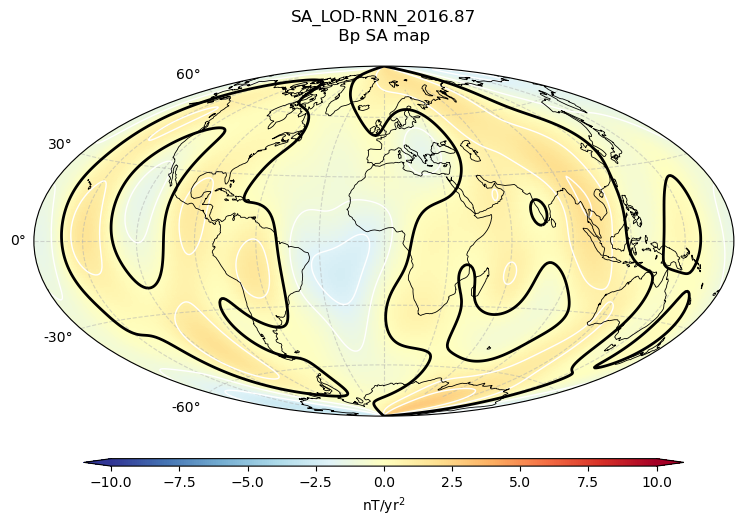

SA_LOD-RNN_2017.12
contains np.nan?  False
plot done


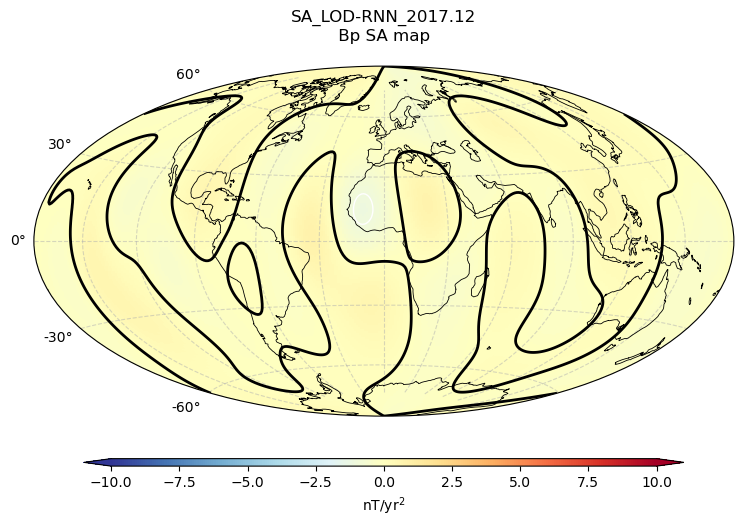

SA_LOD-RNN_2017.37
contains np.nan?  False
plot done


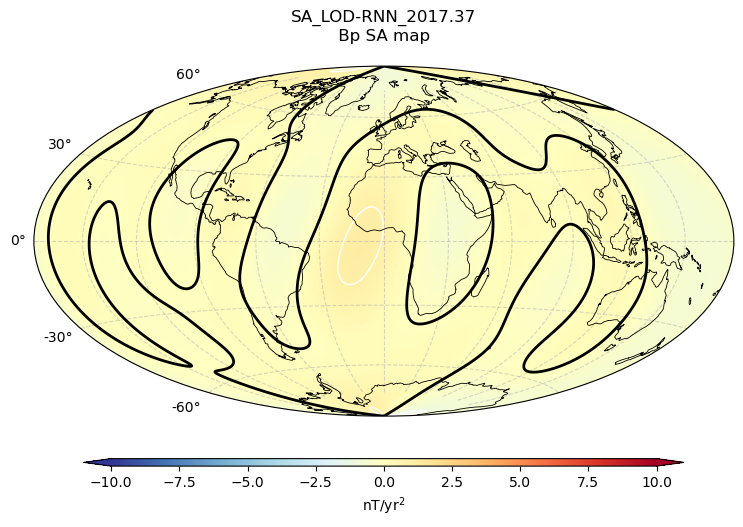

SA_RNN-MCM_2014.12
contains np.nan?  False
plot done


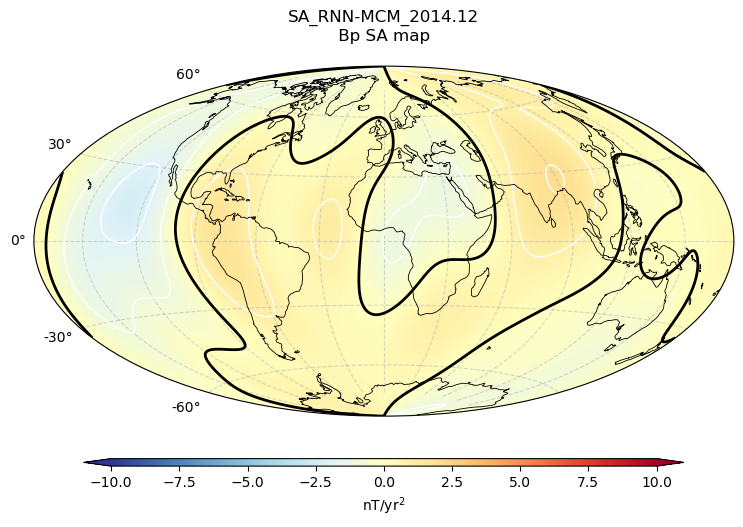

SA_RNN-MCM_2014.37
contains np.nan?  False
plot done


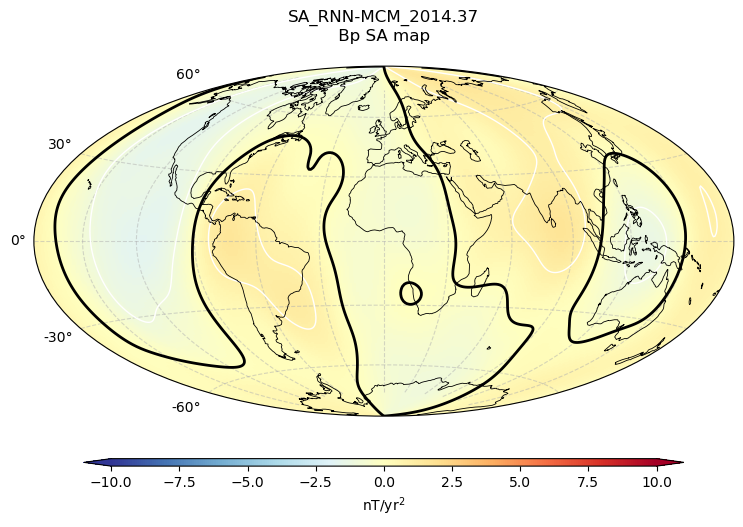

SA_RNN-MCM_2014.62
contains np.nan?  False
plot done


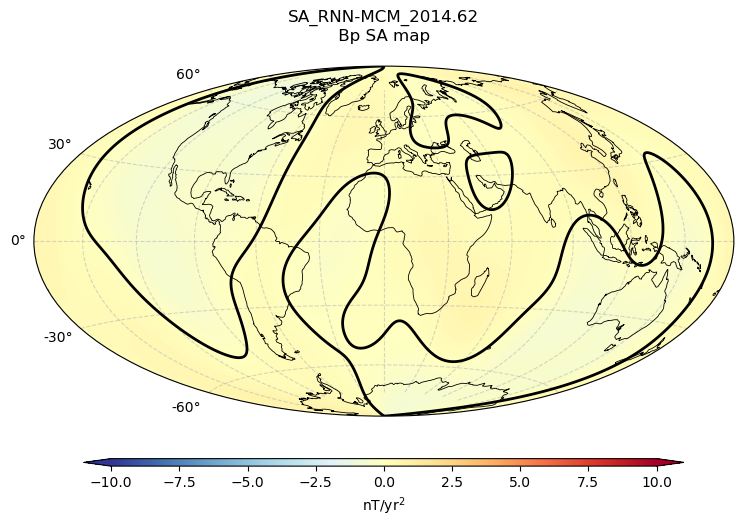

SA_RNN-MCM_2014.87
contains np.nan?  False
plot done


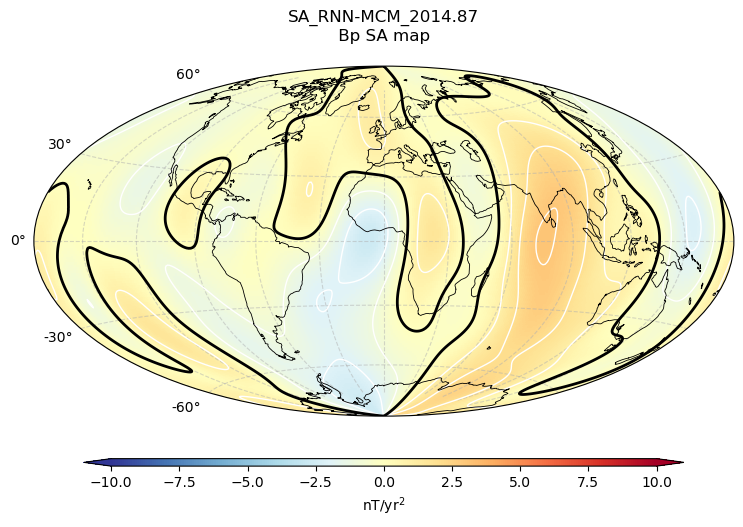

SA_RNN-MCM_2015.13
contains np.nan?  False
plot done


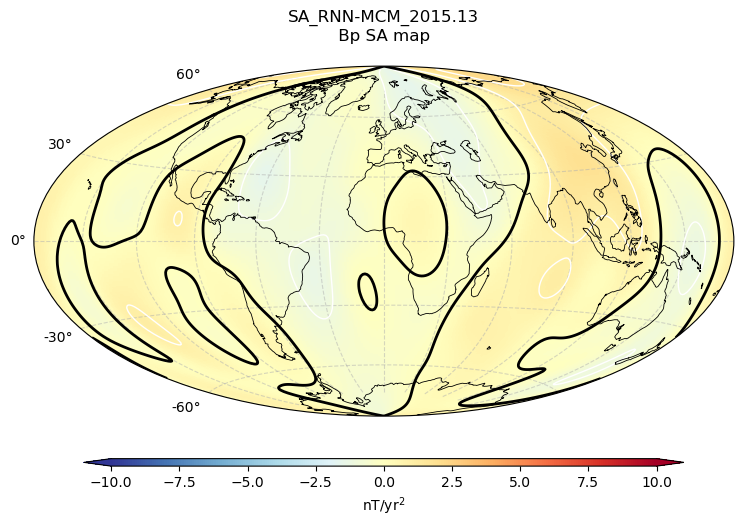

SA_RNN-MCM_2015.38
contains np.nan?  False
plot done


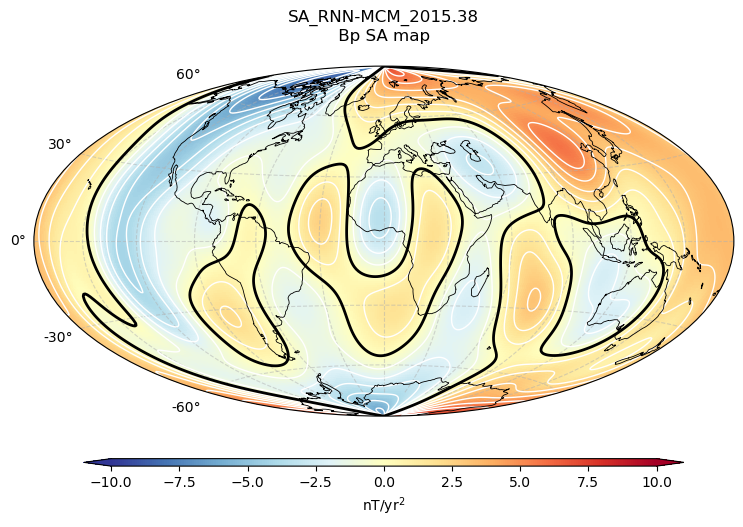

SA_RNN-MCM_2015.63
contains np.nan?  False
plot done


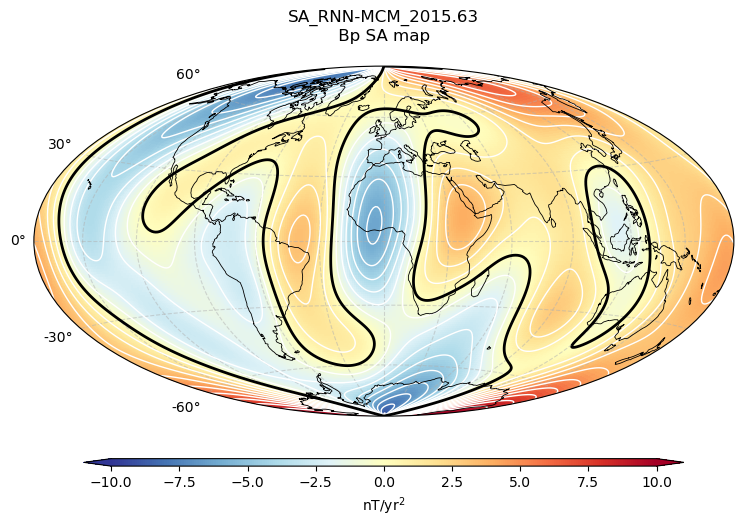

SA_RNN-MCM_2015.88
contains np.nan?  False
plot done


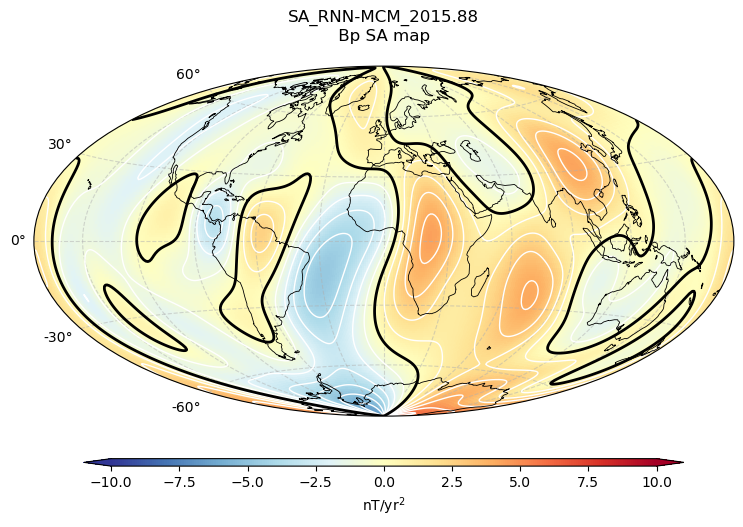

SA_RNN-MCM_2016.12
contains np.nan?  False
plot done


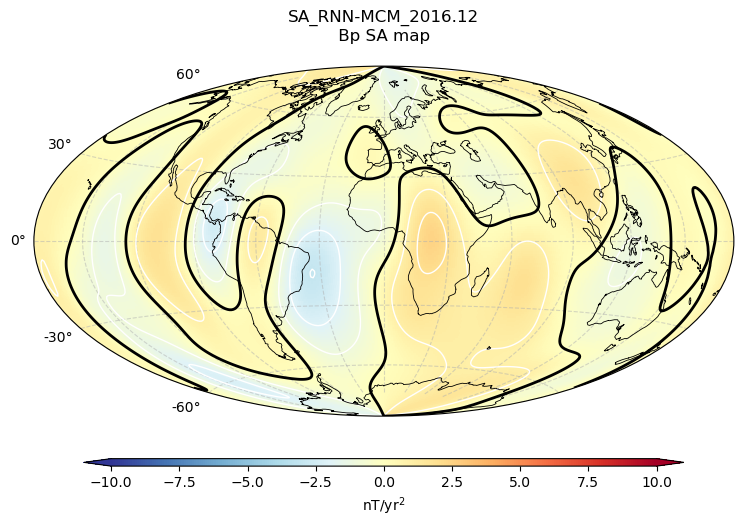

SA_RNN-MCM_2016.37
contains np.nan?  False
plot done


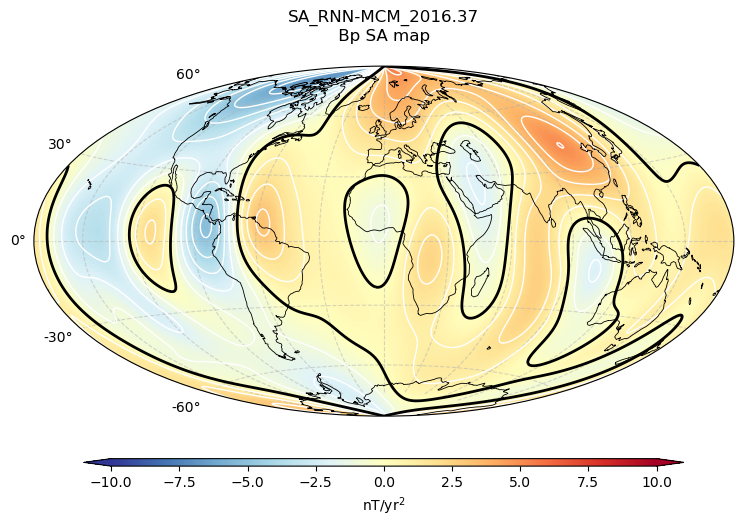

SA_RNN-MCM_2016.62
contains np.nan?  False
plot done


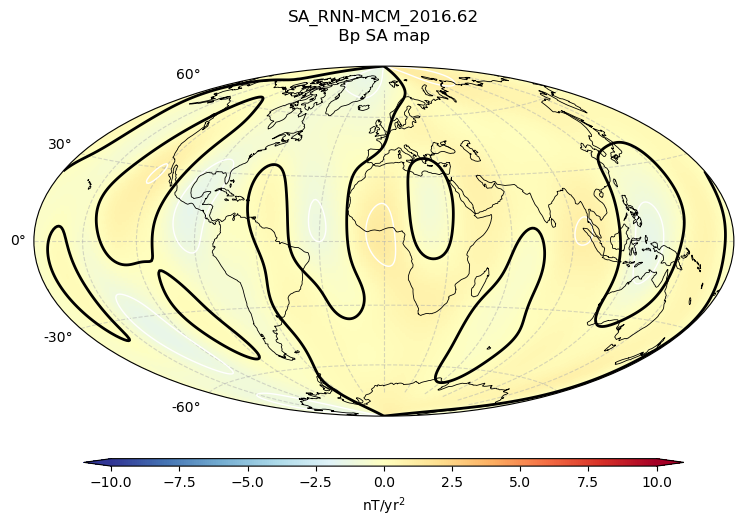

SA_RNN-MCM_2016.87
contains np.nan?  False
plot done


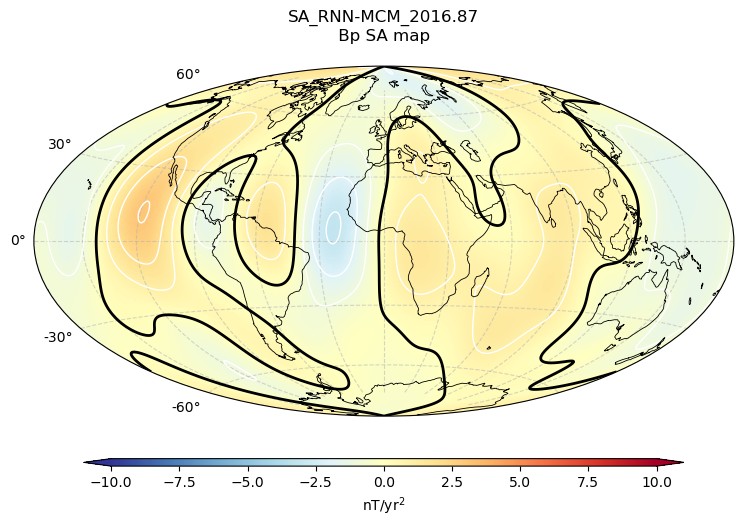

SA_RNN-MCM_2017.12
contains np.nan?  False
plot done


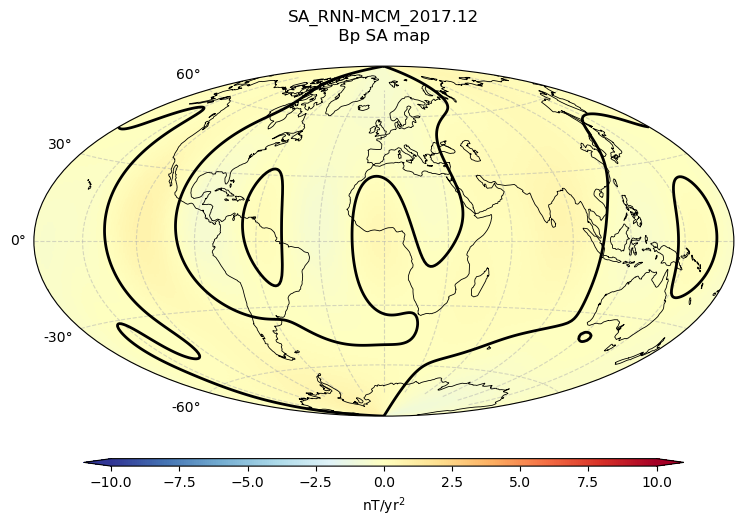

SA_RNN-MCM_2017.37
contains np.nan?  False
plot done


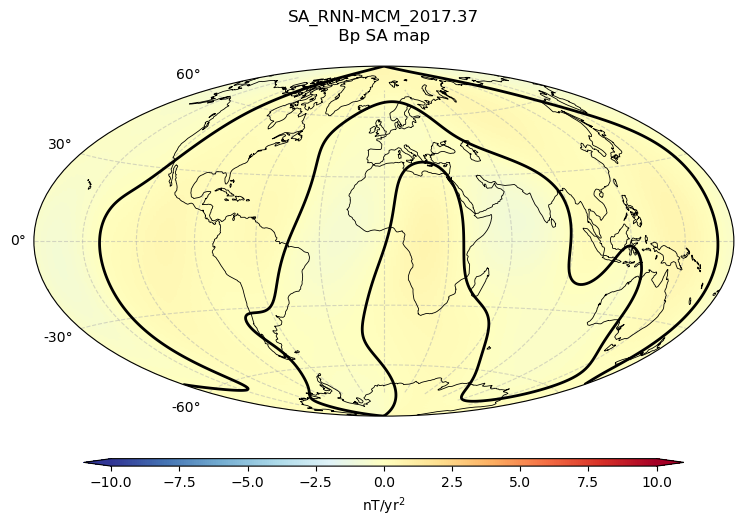

In [6]:
"""

Sixth Test: Plot a series of small maps showing the main field or SV
differences in a chosen component (default 'Z') against the other candidates

Can take several minutes depending on the machine speed

Based on the example from
https://kpegion.github.io/Pangeo-at-AOES/examples/multi-panel-cartopy.html


"""

component = 'Bp'    # Choose X, Y or Z, Br, Bt, Bp


# Define the contour levels to use in plt.contourf
min_max = 10 #nT
contour = 1 # nT
clevs=np.arange(-min_max,min_max+1,contour)


# Set up a lat/long grid  every 5 degrees
max_lon = 180
max_lat = 90
num_lon = int(2 * max_lon) + 1
num_lat = int(2 * max_lat) + 1
longs  = np.linspace(-max_lon, max_lon, num_lon)
lats   = np.linspace(-max_lat, max_lat, num_lat)
RREF = 6371.2 # standard geomagnetic Earth radius (in km)


# PLOT --------------------------------------------------------------
# Use an axis counter to ensure no gaps in the middle subplots
#Loop over all of the models
for j in range(num_candidates):
    # Define the figure and each axis for the 3 rows and 3 columns
    fig, axes = plt.subplots(subplot_kw={'projection': 'hammer'},
                            figsize=(10,5), squeeze=False)

    ax = axes[0,0]
    # Compute the Gauss coefficient differences
    # skip the pos[0] model (or it will be empty)

    print(institute_name[j])
    # D. Kerridge's code includes the monopole for SHA computation
    gh = np.append(0., coeffs[:,j])

    # Compute the maps of differences and save to a dict for ease
    # of plotting an individual element
    Bx, By, Bz = zip(*[shal.shm_calculator(gh,degree,RREF, \
                                            90-lat,lon, \
                                            'Geocentric') \
                        for lat in lats for lon in longs])
    X = np.asarray(Bx).reshape(num_lat,num_lon)
    Y = np.asarray(By).reshape(num_lat,num_lon)
    Z = np.asarray(Bz).reshape(num_lat,num_lon)
    elements={'X':X, 'Y':Y, 'Z':Z, 'Br':-Z, 'Bt':-X, 'Bp':Y}

    # Filled colour plot
    cs=ax.pcolormesh(np.radians(longs), np.radians(lats),
                        elements[component],
                        cmap='RdYlBu_r',
                        vmin=clevs.min(),
                        vmax=clevs.max()
                    )

    print("contains np.nan? ", np.isnan(elements[component]).any())

    # cs = ax.contourf(np.radians(longs), np.radians(lats),
    #                  elements[component],
    #                  levels=clevs,
    #                  cmap='RdYlBu_r', extend='both') # works weirdly

    for lev in clevs:
        line_c = ax.contour(np.radians(longs), np.radians(lats),
                            elements[component],
                            levels=[lev], alpha=1.0,
                            colors=['white'], linewidths=1,
                            negative_linestyles='solid')

    # Add the zero contours
    line_c = ax.contour(np.radians(longs), np.radians(lats),
                        elements[component],
                        levels=[0], alpha=1.0,
                        colors=['black'], linewidths=2.0, 
                        linestyles='solid')
    print("plot done")

    # FORMAT --------------------------------------------------------------
    # Title each subplot with the name of the model
    ax.set_title(institute_name[j] + f"\n {component} SA map \n")

    # Draw the coastines for each subplot
    # read shape-file and plot coast lines
    with shapefile.Reader(shp) as sf:

        for rec in sf.shapeRecords():
            lon_coast = np.radians([point[0] for point in rec.shape.points[:]])
            lat_coast = np.radians([point[1] for point in rec.shape.points[:]])

            ax.plot(lon_coast, lat_coast, color='k', linewidth=0.6, alpha=1.0)


    ax.xaxis.set_ticks(np.radians(np.linspace(-180., 180., num=13)))  # meridians
    ax.yaxis.set_ticks(np.radians(np.linspace(-60., 60., num=5)))  # parallels
    ax.xaxis.set_major_formatter('')  # remove labels from meridians
    ax.grid(True, linestyle='--', alpha=0.5)

    # plt.suptitle('Br SV map')

    # Adjust the location of the subplots on the page to make room for the colorbar
    fig.subplots_adjust(bottom=0.2, top=0.9, left=0.05, right=0.95,
                        wspace=0.1, hspace=0.5)

    # Add a colorbar axis at the bottom of the graph
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.015])

    # Draw the colorbar
    cbar=fig.colorbar(cs, cax=cbar_ax,orientation='horizontal', label=r'nT/yr$^2$', extend='both')

    plt.savefig(f'./SA_gap_cofs/{institute_name[j]}_{component}.png', dpi=300)
    plt.show()